# Afriat

In [1]:
scan=0.10

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: 6wrcfgjz
Name: valiant-bee-108
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/6wrcfgjz
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-6wrcfgjz/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100-PCIE-40GB MIG 3g.20gb') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [MIG-5f1dabc9-296d-5f69-a212-e7de5c7586cb]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2584,3310,9349
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2584,2541,1680,3464,1655,3319
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4499,10744
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 621,799,2390
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 621,661,428,826,394,880
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1085,2725
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:12<2:06:22, 12.66s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:06:22, 12.66s/it, v_num=jz_1, total_loss_train=3.67e+3, kl_local_train=40.7]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:12<2:06:22, 12.66s/it, v_num=jz_1, total_loss_train=3.67e+3, kl_local_train=40.7]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:17<1:23:03,  8.33s/it, v_num=jz_1, total_loss_train=3.67e+3, kl_local_train=40.7]

Epoch 2/600:   0%|▌                                                                                                                                                         | 2/600 [00:17<1:23:03,  8.33s/it, v_num=jz_1, total_loss_train=3.22e+3, kl_local_train=55]

Epoch 3/600:   0%|▌                                                                                                                                                         | 2/600 [00:17<1:23:03,  8.33s/it, v_num=jz_1, total_loss_train=3.22e+3, kl_local_train=55]

Epoch 3/600:   0%|▊                                                                                                                                                         | 3/600 [00:24<1:14:02,  7.44s/it, v_num=jz_1, total_loss_train=3.22e+3, kl_local_train=55]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:24<1:14:02,  7.44s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=53.9]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:24<1:14:02,  7.44s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=53.9]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:30<1:09:08,  6.96s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=53.9]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:30<1:09:08,  6.96s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=49.8]

Epoch 5/600:   1%|█                                                                                                                                                        | 4/600 [00:30<1:09:08,  6.96s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=49.8]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [00:36<1:03:53,  6.44s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=49.8]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [00:36<1:03:53,  6.44s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=41.4]

Epoch 6/600:   1%|█▎                                                                                                                                                       | 5/600 [00:37<1:03:53,  6.44s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=41.4]

Epoch 6/600:   1%|█▌                                                                                                                                                       | 6/600 [00:42<1:04:22,  6.50s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=41.4]

Epoch 6/600:   1%|▏                    | 6/600 [00:42<1:04:22,  6.50s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=32.2, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 7/600:   1%|▏                    | 6/600 [00:42<1:04:22,  6.50s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=32.2, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 7/600:   1%|▏                    | 7/600 [00:48<1:01:36,  6.23s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=32.2, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 7/600:   1%|▏                    | 7/600 [00:48<1:01:36,  6.23s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 8/600:   1%|▏                    | 7/600 [00:48<1:01:36,  6.23s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 8/600:   1%|▎                      | 8/600 [00:53<58:31,  5.93s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=33.1, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 8/600:   1%|▎                      | 8/600 [00:53<58:31,  5.93s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 9/600:   1%|▎                      | 8/600 [00:53<58:31,  5.93s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 9/600:   2%|▎                    | 9/600 [01:00<1:00:12,  6.11s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=29.6, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 9/600:   2%|▎                    | 9/600 [01:00<1:00:12,  6.11s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 10/600:   2%|▎                   | 9/600 [01:00<1:00:12,  6.11s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 10/600:   2%|▎                    | 10/600 [01:05<58:06,  5.91s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 10/600:   2%|▎                    | 10/600 [01:05<58:06,  5.91s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 11/600:   2%|▎                    | 10/600 [01:06<58:06,  5.91s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 11/600:   2%|▍                    | 11/600 [01:12<59:53,  6.10s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.0179, metric_mi|time_cat_train=0.0127, metric_mi|mouse_train=0.0355]

Epoch 11/600:   2%|▍                      | 11/600 [01:12<59:53,  6.10s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 12/600:   2%|▍                      | 11/600 [01:12<59:53,  6.10s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 12/600:   2%|▍                    | 12/600 [01:19<1:03:34,  6.49s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 12/600:   2%|▍                    | 12/600 [01:19<1:03:34,  6.49s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 13/600:   2%|▍                    | 12/600 [01:19<1:03:34,  6.49s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 13/600:   2%|▍                    | 13/600 [01:24<1:00:20,  6.17s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 13/600:   2%|▍                    | 13/600 [01:24<1:00:20,  6.17s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 14/600:   2%|▍                    | 13/600 [01:24<1:00:20,  6.17s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 14/600:   2%|▌                      | 14/600 [01:30<57:53,  5.93s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 14/600:   2%|▌                      | 14/600 [01:30<57:53,  5.93s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 15/600:   2%|▌                      | 14/600 [01:30<57:53,  5.93s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 15/600:   2%|▌                      | 15/600 [01:36<59:25,  6.09s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 15/600:   2%|▌                      | 15/600 [01:36<59:25,  6.09s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 16/600:   2%|▌                      | 15/600 [01:37<59:25,  6.09s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 16/600:   3%|▌                    | 16/600 [01:43<1:00:42,  6.24s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.063]

Epoch 16/600:   3%|▌                  | 16/600 [01:43<1:00:42,  6.24s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 17/600:   3%|▌                  | 16/600 [01:43<1:00:42,  6.24s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 17/600:   3%|▌                  | 17/600 [01:49<1:01:27,  6.33s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 17/600:   3%|▌                  | 17/600 [01:49<1:01:27,  6.33s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=59.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 18/600:   3%|▌                  | 17/600 [01:49<1:01:27,  6.33s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=59.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 18/600:   3%|▌                  | 18/600 [01:56<1:00:56,  6.28s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=59.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 18/600:   3%|▌                  | 18/600 [01:56<1:00:56,  6.28s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 19/600:   3%|▌                  | 18/600 [01:56<1:00:56,  6.28s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 19/600:   3%|▋                    | 19/600 [02:01<58:42,  6.06s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=62.7, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 19/600:   3%|▋                    | 19/600 [02:01<58:42,  6.06s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 20/600:   3%|▋                    | 19/600 [02:01<58:42,  6.06s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 20/600:   3%|▋                  | 20/600 [02:08<1:00:50,  6.29s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 20/600:   3%|▋                  | 20/600 [02:08<1:00:50,  6.29s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 21/600:   3%|▋                  | 20/600 [02:09<1:00:50,  6.29s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 21/600:   4%|▋                  | 21/600 [02:17<1:07:14,  6.97s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0718]

Epoch 21/600:   4%|▋                  | 21/600 [02:17<1:07:14,  6.97s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 22/600:   4%|▋                  | 21/600 [02:17<1:07:14,  6.97s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 22/600:   4%|▋                  | 22/600 [02:22<1:03:40,  6.61s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 22/600:   4%|▋                  | 22/600 [02:22<1:03:40,  6.61s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=80.9, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 23/600:   4%|▋                  | 22/600 [02:22<1:03:40,  6.61s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=80.9, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 23/600:   4%|▋                  | 23/600 [02:29<1:03:19,  6.58s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=80.9, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 23/600:   4%|▋                  | 23/600 [02:29<1:03:19,  6.58s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=85.7, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 24/600:   4%|▋                  | 23/600 [02:29<1:03:19,  6.58s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=85.7, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 24/600:   4%|▊                  | 24/600 [02:35<1:03:08,  6.58s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=85.7, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 24/600:   4%|▊                  | 24/600 [02:35<1:03:08,  6.58s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=89.8, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 25/600:   4%|▊                  | 24/600 [02:35<1:03:08,  6.58s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=89.8, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 25/600:   4%|▊                  | 25/600 [02:42<1:01:47,  6.45s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=89.8, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 25/600:   4%|▊                  | 25/600 [02:42<1:01:47,  6.45s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 26/600:   4%|▊                  | 25/600 [02:43<1:01:47,  6.45s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 26/600:   4%|▊                  | 26/600 [02:50<1:08:32,  7.16s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.0553, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0889]

Epoch 26/600:   4%|▊                   | 26/600 [02:50<1:08:32,  7.16s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=97.9, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 27/600:   4%|▊                   | 26/600 [02:50<1:08:32,  7.16s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=97.9, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 27/600:   4%|▉                   | 27/600 [02:56<1:03:58,  6.70s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=97.9, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 27/600:   4%|▉                    | 27/600 [02:56<1:03:58,  6.70s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 28/600:   4%|▉                    | 27/600 [02:56<1:03:58,  6.70s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 28/600:   5%|▉                    | 28/600 [03:03<1:03:29,  6.66s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 28/600:   5%|▉                    | 28/600 [03:03<1:03:29,  6.66s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 29/600:   5%|▉                    | 28/600 [03:03<1:03:29,  6.66s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 29/600:   5%|█                    | 29/600 [03:08<1:00:17,  6.34s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 29/600:   5%|█                    | 29/600 [03:08<1:00:17,  6.34s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 30/600:   5%|█                    | 29/600 [03:08<1:00:17,  6.34s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 30/600:   5%|█                    | 30/600 [03:15<1:00:37,  6.38s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 30/600:   5%|█                    | 30/600 [03:15<1:00:37,  6.38s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 31/600:   5%|█                    | 30/600 [03:16<1:00:37,  6.38s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 31/600:   5%|█                    | 31/600 [03:22<1:03:32,  6.70s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.102]

Epoch 31/600:   5%|█                    | 31/600 [03:22<1:03:32,  6.70s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 32/600:   5%|█                    | 31/600 [03:22<1:03:32,  6.70s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 32/600:   5%|█                    | 32/600 [03:28<1:00:11,  6.36s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 32/600:   5%|█                    | 32/600 [03:28<1:00:11,  6.36s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 33/600:   5%|█                    | 32/600 [03:28<1:00:11,  6.36s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 33/600:   6%|█▎                     | 33/600 [03:33<57:55,  6.13s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 33/600:   6%|█▎                     | 33/600 [03:33<57:55,  6.13s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 34/600:   6%|█▎                     | 33/600 [03:33<57:55,  6.13s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 34/600:   6%|█▎                     | 34/600 [03:40<58:59,  6.25s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 34/600:   6%|█▎                     | 34/600 [03:40<58:59,  6.25s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 35/600:   6%|█▎                     | 34/600 [03:40<58:59,  6.25s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 35/600:   6%|█▏                   | 35/600 [03:47<1:01:49,  6.57s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 35/600:   6%|█▏                   | 35/600 [03:47<1:01:49,  6.57s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 36/600:   6%|█▏                   | 35/600 [03:49<1:01:49,  6.57s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 36/600:   6%|█▎                   | 36/600 [03:54<1:04:06,  6.82s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0936, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.106]

Epoch 36/600:   6%|█▍                     | 36/600 [03:54<1:04:06,  6.82s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 37/600:   6%|█▍                     | 36/600 [03:54<1:04:06,  6.82s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 37/600:   6%|█▍                     | 37/600 [04:00<1:00:39,  6.46s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 37/600:   6%|█▍                     | 37/600 [04:00<1:00:39,  6.46s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 38/600:   6%|█▍                     | 37/600 [04:00<1:00:39,  6.46s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 38/600:   6%|█▍                     | 38/600 [04:07<1:00:52,  6.50s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 38/600:   6%|█▍                     | 38/600 [04:07<1:00:52,  6.50s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 39/600:   6%|█▍                     | 38/600 [04:07<1:00:52,  6.50s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 39/600:   6%|█▍                     | 39/600 [04:13<1:01:03,  6.53s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 39/600:   6%|█▍                     | 39/600 [04:13<1:01:03,  6.53s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 40/600:   6%|█▍                     | 39/600 [04:13<1:01:03,  6.53s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 40/600:   7%|█▋                       | 40/600 [04:19<58:23,  6.26s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 40/600:   7%|█▋                       | 40/600 [04:19<58:23,  6.26s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 41/600:   7%|█▋                       | 40/600 [04:20<58:23,  6.26s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 41/600:   7%|█▌                     | 41/600 [04:26<1:01:53,  6.64s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.109]

Epoch 41/600:   7%|█▋                      | 41/600 [04:26<1:01:53,  6.64s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 42/600:   7%|█▋                      | 41/600 [04:26<1:01:53,  6.64s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 42/600:   7%|█▋                      | 42/600 [04:34<1:03:26,  6.82s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 42/600:   7%|█▋                      | 42/600 [04:34<1:03:26,  6.82s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 43/600:   7%|█▋                      | 42/600 [04:34<1:03:26,  6.82s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 43/600:   7%|█▋                      | 43/600 [04:39<1:00:08,  6.48s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 43/600:   7%|█▋                      | 43/600 [04:39<1:00:08,  6.48s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 44/600:   7%|█▋                      | 43/600 [04:39<1:00:08,  6.48s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 44/600:   7%|█▉                        | 44/600 [04:45<57:46,  6.23s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 44/600:   7%|█▉                        | 44/600 [04:45<57:46,  6.23s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 45/600:   7%|█▉                        | 44/600 [04:45<57:46,  6.23s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 45/600:   8%|█▊                      | 45/600 [04:52<1:00:38,  6.56s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 45/600:   8%|█▊                      | 45/600 [04:52<1:00:38,  6.56s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 46/600:   8%|█▊                      | 45/600 [04:53<1:00:38,  6.56s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 46/600:   8%|█▊                      | 46/600 [04:59<1:00:53,  6.59s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.111]

Epoch 46/600:   8%|█▉                       | 46/600 [04:59<1:00:53,  6.59s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 47/600:   8%|█▉                       | 46/600 [04:59<1:00:53,  6.59s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 47/600:   8%|█▉                       | 47/600 [05:07<1:04:06,  6.95s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 47/600:   8%|█▉                       | 47/600 [05:07<1:04:06,  6.95s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 48/600:   8%|█▉                       | 47/600 [05:07<1:04:06,  6.95s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 48/600:   8%|██                       | 48/600 [05:13<1:01:10,  6.65s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 48/600:   8%|██                       | 48/600 [05:13<1:01:10,  6.65s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 49/600:   8%|██                       | 48/600 [05:13<1:01:10,  6.65s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 49/600:   8%|██▏                        | 49/600 [05:18<58:20,  6.35s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 49/600:   8%|██▏                        | 49/600 [05:18<58:20,  6.35s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 50/600:   8%|██▏                        | 49/600 [05:18<58:20,  6.35s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 50/600:   8%|██▎                        | 50/600 [05:24<56:24,  6.15s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 50/600:   8%|██▏                       | 50/600 [05:24<56:24,  6.15s/it, v_num=jz_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 51/600:   8%|██▏                       | 50/600 [05:25<56:24,  6.15s/it, v_num=jz_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 51/600:   8%|██▏                       | 51/600 [05:31<57:46,  6.31s/it, v_num=jz_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 51/600:   8%|██▎                        | 51/600 [05:31<57:46,  6.31s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 52/600:   8%|██▎                        | 51/600 [05:31<57:46,  6.31s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 52/600:   9%|██▎                        | 52/600 [05:36<55:57,  6.13s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 52/600:   9%|██▎                        | 52/600 [05:37<55:57,  6.13s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 53/600:   9%|██▎                        | 52/600 [05:37<55:57,  6.13s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 53/600:   9%|██▍                        | 53/600 [05:42<54:25,  5.97s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 53/600:   9%|██▎                       | 53/600 [05:42<54:25,  5.97s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=99.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 54/600:   9%|██▎                       | 53/600 [05:42<54:25,  5.97s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=99.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 54/600:   9%|██▎                       | 54/600 [05:48<53:06,  5.84s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=99.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 54/600:   9%|██▎                       | 54/600 [05:48<53:06,  5.84s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 55/600:   9%|██▎                       | 54/600 [05:48<53:06,  5.84s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 55/600:   9%|██▍                       | 55/600 [05:54<53:33,  5.90s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 55/600:   9%|██▌                         | 55/600 [05:54<53:33,  5.90s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 56/600:   9%|██▌                         | 55/600 [05:55<53:33,  5.90s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 56/600:   9%|██▌                         | 56/600 [06:01<57:32,  6.35s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=97, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.115]

Epoch 56/600:   9%|██▌                        | 56/600 [06:01<57:32,  6.35s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=95.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 57/600:   9%|██▌                        | 56/600 [06:01<57:32,  6.35s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=95.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 57/600:  10%|██▌                        | 57/600 [06:08<58:12,  6.43s/it, v_num=jz_1, total_loss_train=3.2e+3, kl_local_train=95.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 57/600:  10%|██▋                         | 57/600 [06:08<58:12,  6.43s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=96, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 58/600:  10%|██▋                         | 57/600 [06:08<58:12,  6.43s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=96, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 58/600:  10%|██▋                         | 58/600 [06:13<55:55,  6.19s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=96, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 58/600:  10%|██▌                       | 58/600 [06:13<55:55,  6.19s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=95.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 59/600:  10%|██▌                       | 58/600 [06:13<55:55,  6.19s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=95.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 59/600:  10%|██▌                       | 59/600 [06:21<58:35,  6.50s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=95.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 59/600:  10%|██▊                         | 59/600 [06:21<58:35,  6.50s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=93, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 60/600:  10%|██▊                         | 59/600 [06:21<58:35,  6.50s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=93, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 60/600:  10%|██▊                         | 60/600 [06:27<58:57,  6.55s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=93, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 60/600:  10%|██▌                       | 60/600 [06:27<58:57,  6.55s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 61/600:  10%|██▌                       | 60/600 [06:29<58:57,  6.55s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 61/600:  10%|██▍                     | 61/600 [06:36<1:04:02,  7.13s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 61/600:  10%|██▎                    | 61/600 [06:36<1:04:02,  7.13s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 62/600:  10%|██▎                    | 61/600 [06:36<1:04:02,  7.13s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 62/600:  10%|██▍                    | 62/600 [06:42<1:02:28,  6.97s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 62/600:  10%|██▍                    | 62/600 [06:42<1:02:28,  6.97s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 63/600:  10%|██▍                    | 62/600 [06:42<1:02:28,  6.97s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 63/600:  10%|██▋                      | 63/600 [06:48<58:51,  6.58s/it, v_num=jz_1, total_loss_train=3.19e+3, kl_local_train=91.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 63/600:  10%|██▋                      | 63/600 [06:48<58:51,  6.58s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=90.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 64/600:  10%|██▋                      | 63/600 [06:48<58:51,  6.58s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=90.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 64/600:  11%|██▋                      | 64/600 [06:54<56:02,  6.27s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=90.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 64/600:  11%|██▉                        | 64/600 [06:54<56:02,  6.27s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 65/600:  11%|██▉                        | 64/600 [06:54<56:02,  6.27s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 65/600:  11%|██▉                        | 65/600 [06:59<54:07,  6.07s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 65/600:  11%|██▋                      | 65/600 [06:59<54:07,  6.07s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 66/600:  11%|██▋                      | 65/600 [07:01<54:07,  6.07s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 66/600:  11%|██▊                      | 66/600 [07:06<56:51,  6.39s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 66/600:  11%|██▊                       | 66/600 [07:06<56:51,  6.39s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=87.4, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 67/600:  11%|██▊                       | 66/600 [07:06<56:51,  6.39s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=87.4, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 67/600:  11%|██▉                       | 67/600 [07:14<59:45,  6.73s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=87.4, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 67/600:  11%|██▉                       | 67/600 [07:14<59:45,  6.73s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 68/600:  11%|██▉                       | 67/600 [07:14<59:45,  6.73s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 68/600:  11%|██▉                       | 68/600 [07:19<56:47,  6.41s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 68/600:  11%|██▉                       | 68/600 [07:19<56:47,  6.41s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 69/600:  11%|██▉                       | 68/600 [07:19<56:47,  6.41s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 69/600:  12%|██▉                       | 69/600 [07:26<57:24,  6.49s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 69/600:  12%|██▉                       | 69/600 [07:26<57:24,  6.49s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 70/600:  12%|██▉                       | 69/600 [07:26<57:24,  6.49s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 70/600:  12%|██▊                     | 70/600 [07:34<1:00:38,  6.87s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 70/600:  12%|███                       | 70/600 [07:34<1:00:38,  6.87s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 71/600:  12%|███                       | 70/600 [07:35<1:00:38,  6.87s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 71/600:  12%|███                       | 71/600 [07:41<1:00:18,  6.84s/it, v_num=jz_1, total_loss_train=3.18e+3, kl_local_train=84, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 71/600:  12%|██▉                      | 71/600 [07:41<1:00:18,  6.84s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 72/600:  12%|██▉                      | 71/600 [07:41<1:00:18,  6.84s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 72/600:  12%|███▏                       | 72/600 [07:47<59:37,  6.78s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 72/600:  12%|███                      | 72/600 [07:47<59:37,  6.78s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 73/600:  12%|███                      | 72/600 [07:47<59:37,  6.78s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 73/600:  12%|███                      | 73/600 [07:53<56:33,  6.44s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=82.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 73/600:  12%|███                      | 73/600 [07:53<56:33,  6.44s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=81.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 74/600:  12%|███                      | 73/600 [07:53<56:33,  6.44s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=81.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 74/600:  12%|███                      | 74/600 [07:58<54:15,  6.19s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=81.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 74/600:  12%|███                      | 74/600 [07:58<54:15,  6.19s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 75/600:  12%|███                      | 74/600 [07:59<54:15,  6.19s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 75/600:  12%|███▏                     | 75/600 [08:04<52:39,  6.02s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 75/600:  12%|███▏                     | 75/600 [08:04<52:39,  6.02s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 76/600:  12%|███▏                     | 75/600 [08:05<52:39,  6.02s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 76/600:  13%|███▏                     | 76/600 [08:11<54:23,  6.23s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 76/600:  13%|███▏                     | 76/600 [08:11<54:23,  6.23s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 77/600:  13%|███▏                     | 76/600 [08:11<54:23,  6.23s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 77/600:  13%|███▏                     | 77/600 [08:17<55:20,  6.35s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 77/600:  13%|███▏                     | 77/600 [08:17<55:20,  6.35s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 78/600:  13%|███▏                     | 77/600 [08:17<55:20,  6.35s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 78/600:  13%|███▎                     | 78/600 [08:24<56:09,  6.45s/it, v_num=jz_1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 78/600:  13%|███▎                     | 78/600 [08:24<56:09,  6.45s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 79/600:  13%|███▎                     | 78/600 [08:24<56:09,  6.45s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 79/600:  13%|███▎                     | 79/600 [08:30<53:53,  6.21s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 79/600:  13%|███▎                     | 79/600 [08:30<53:53,  6.21s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 80/600:  13%|███▎                     | 79/600 [08:30<53:53,  6.21s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 80/600:  13%|███▎                     | 80/600 [08:36<52:41,  6.08s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=78.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 80/600:  13%|███▎                     | 80/600 [08:36<52:41,  6.08s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 81/600:  13%|███▎                     | 80/600 [08:37<52:41,  6.08s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 81/600:  14%|███▍                     | 81/600 [08:42<54:24,  6.29s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 81/600:  14%|███▋                       | 81/600 [08:42<54:24,  6.29s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=77, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|███▋                       | 81/600 [08:42<54:24,  6.29s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=77, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|███▋                       | 82/600 [08:48<52:39,  6.10s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=77, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|███▌                      | 82/600 [08:48<52:39,  6.10s/it, v_num=jz_1, total_loss_train=3160.0, kl_local_train=76.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|███▌                      | 82/600 [08:48<52:39,  6.10s/it, v_num=jz_1, total_loss_train=3160.0, kl_local_train=76.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|███▌                      | 83/600 [08:54<51:04,  5.93s/it, v_num=jz_1, total_loss_train=3160.0, kl_local_train=76.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|███▍                     | 83/600 [08:54<51:04,  5.93s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=76.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|███▍                     | 83/600 [08:54<51:04,  5.93s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=76.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|███▌                     | 84/600 [09:01<54:55,  6.39s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=76.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|███▌                     | 84/600 [09:01<54:55,  6.39s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=75.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|███▌                     | 84/600 [09:01<54:55,  6.39s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=75.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|███▌                     | 85/600 [09:09<57:51,  6.74s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=75.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|███▌                     | 85/600 [09:09<57:51,  6.74s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|███▌                     | 85/600 [09:10<57:51,  6.74s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|███▌                     | 86/600 [09:16<59:52,  6.99s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|███▌                     | 86/600 [09:16<59:52,  6.99s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=74.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|███▌                     | 86/600 [09:16<59:52,  6.99s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=74.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|███▌                     | 87/600 [09:22<56:20,  6.59s/it, v_num=jz_1, total_loss_train=3.16e+3, kl_local_train=74.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 87/600:  14%|███▌                     | 87/600 [09:22<56:20,  6.59s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 88/600:  14%|███▌                     | 87/600 [09:22<56:20,  6.59s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 88/600:  15%|███▋                     | 88/600 [09:28<54:05,  6.34s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 88/600:  15%|███▉                       | 88/600 [09:28<54:05,  6.34s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=74, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|███▉                       | 88/600 [09:28<54:05,  6.34s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=74, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|████                       | 89/600 [09:33<52:33,  6.17s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=74, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 89/600:  15%|███▋                     | 89/600 [09:33<52:33,  6.17s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|███▋                     | 89/600 [09:33<52:33,  6.17s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|███▊                     | 90/600 [09:39<51:17,  6.04s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 90/600:  15%|███▊                     | 90/600 [09:39<51:17,  6.04s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|███▊                     | 90/600 [09:40<51:17,  6.04s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|███▊                     | 91/600 [09:46<53:05,  6.26s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 91/600:  15%|███▊                     | 91/600 [09:46<53:05,  6.26s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|███▊                     | 91/600 [09:46<53:05,  6.26s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|███▊                     | 92/600 [09:52<52:00,  6.14s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 92/600:  15%|████▏                      | 92/600 [09:52<52:00,  6.14s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 93/600:  15%|████▏                      | 92/600 [09:52<52:00,  6.14s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 93/600:  16%|████▏                      | 93/600 [09:58<51:13,  6.06s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=72, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 93/600:  16%|███▉                     | 93/600 [09:58<51:13,  6.06s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|███▉                     | 93/600 [09:58<51:13,  6.06s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|███▉                     | 94/600 [10:05<54:36,  6.47s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 94/600:  16%|███▉                     | 94/600 [10:05<54:36,  6.47s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|███▉                     | 94/600 [10:05<54:36,  6.47s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|███▉                     | 95/600 [10:11<53:02,  6.30s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 95/600:  16%|███▉                     | 95/600 [10:11<53:02,  6.30s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|███▉                     | 95/600 [10:12<53:02,  6.30s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|████                     | 96/600 [10:19<57:44,  6.87s/it, v_num=jz_1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 96/600:  16%|████                     | 96/600 [10:19<57:44,  6.87s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|████                     | 96/600 [10:19<57:44,  6.87s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|████                     | 97/600 [10:26<58:42,  7.00s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 97/600:  16%|████                     | 97/600 [10:26<58:42,  7.00s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|████                     | 97/600 [10:26<58:42,  7.00s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|████                     | 98/600 [10:33<58:09,  6.95s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 98/600:  16%|████                     | 98/600 [10:33<58:09,  6.95s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|████                     | 98/600 [10:33<58:09,  6.95s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|████▏                    | 99/600 [10:39<55:14,  6.62s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 99/600:  16%|████▏                    | 99/600 [10:39<55:14,  6.62s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 100/600:  16%|███▉                    | 99/600 [10:39<55:14,  6.62s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|███▊                   | 100/600 [10:45<53:19,  6.40s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 100/600:  17%|███▊                   | 100/600 [10:45<53:19,  6.40s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|███▊                   | 100/600 [10:46<53:19,  6.40s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|███▊                   | 101/600 [10:52<54:29,  6.55s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 101/600:  17%|████▏                    | 101/600 [10:52<54:29,  6.55s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|████▏                    | 101/600 [10:52<54:29,  6.55s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|████▎                    | 102/600 [10:59<56:25,  6.80s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 102/600:  17%|████▌                      | 102/600 [10:59<56:25,  6.80s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|████▌                      | 102/600 [10:59<56:25,  6.80s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|████▋                      | 103/600 [11:05<54:17,  6.55s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 103/600:  17%|████▎                    | 103/600 [11:05<54:17,  6.55s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|████▎                    | 103/600 [11:05<54:17,  6.55s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|████▎                    | 104/600 [11:11<52:43,  6.38s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 104/600:  17%|████▎                    | 104/600 [11:11<52:43,  6.38s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 105/600:  17%|████▎                    | 104/600 [11:11<52:43,  6.38s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 105/600:  18%|████▍                    | 105/600 [11:18<52:26,  6.36s/it, v_num=jz_1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 105/600:  18%|████▍                    | 105/600 [11:18<52:26,  6.36s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|████▍                    | 105/600 [11:19<52:26,  6.36s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|████▍                    | 106/600 [11:25<55:56,  6.79s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 106/600:  18%|████                   | 106/600 [11:25<55:56,  6.79s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 107/600:  18%|████                   | 106/600 [11:25<55:56,  6.79s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 107/600:  18%|████                   | 107/600 [11:32<56:38,  6.89s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 107/600:  18%|████                   | 107/600 [11:32<56:38,  6.89s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 108/600:  18%|████                   | 107/600 [11:32<56:38,  6.89s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 108/600:  18%|████▏                  | 108/600 [11:39<55:30,  6.77s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 108/600:  18%|████▏                  | 108/600 [11:39<55:30,  6.77s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 109/600:  18%|████▏                  | 108/600 [11:39<55:30,  6.77s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 109/600:  18%|████▏                  | 109/600 [11:45<54:24,  6.65s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 109/600:  18%|████▏                  | 109/600 [11:45<54:24,  6.65s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 110/600:  18%|████▏                  | 109/600 [11:45<54:24,  6.65s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 110/600:  18%|████▏                  | 110/600 [11:51<51:49,  6.35s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 110/600:  18%|████▏                  | 110/600 [11:51<51:49,  6.35s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 111/600:  18%|████▏                  | 110/600 [11:52<51:49,  6.35s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 111/600:  18%|████▎                  | 111/600 [11:58<52:41,  6.47s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 111/600:  18%|████                  | 111/600 [11:58<52:41,  6.47s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 112/600:  18%|████                  | 111/600 [11:58<52:41,  6.47s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 112/600:  19%|████                  | 112/600 [12:04<52:16,  6.43s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 112/600:  19%|████▍                   | 112/600 [12:04<52:16,  6.43s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 113/600:  19%|████▍                   | 112/600 [12:04<52:16,  6.43s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 113/600:  19%|████▌                   | 113/600 [12:10<51:07,  6.30s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 113/600:  19%|████▏                 | 113/600 [12:10<51:07,  6.30s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 114/600:  19%|████▏                 | 113/600 [12:10<51:07,  6.30s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 114/600:  19%|████▏                 | 114/600 [12:16<50:18,  6.21s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 114/600:  19%|████▌                   | 114/600 [12:16<50:18,  6.21s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 115/600:  19%|████▌                   | 114/600 [12:16<50:18,  6.21s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 115/600:  19%|████▌                   | 115/600 [12:24<53:43,  6.65s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=64, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 115/600:  19%|████▏                 | 115/600 [12:24<53:43,  6.65s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=63.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 116/600:  19%|████▏                 | 115/600 [12:25<53:43,  6.65s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=63.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 116/600:  19%|████▎                 | 116/600 [12:31<54:25,  6.75s/it, v_num=jz_1, total_loss_train=3.13e+3, kl_local_train=63.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 116/600:  19%|████                 | 116/600 [12:31<54:25,  6.75s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 117/600:  19%|████                 | 116/600 [12:31<54:25,  6.75s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 117/600:  20%|████                 | 117/600 [12:38<54:40,  6.79s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 117/600:  20%|████                 | 117/600 [12:38<54:40,  6.79s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 118/600:  20%|████                 | 117/600 [12:38<54:40,  6.79s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 118/600:  20%|████▏                | 118/600 [12:44<52:32,  6.54s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 118/600:  20%|████▌                  | 118/600 [12:44<52:32,  6.54s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 119/600:  20%|████▌                  | 118/600 [12:44<52:32,  6.54s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 119/600:  20%|████▌                  | 119/600 [12:49<50:57,  6.36s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 119/600:  20%|████▏                | 119/600 [12:49<50:57,  6.36s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 120/600:  20%|████▏                | 119/600 [12:49<50:57,  6.36s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 120/600:  20%|████▏                | 120/600 [12:56<52:07,  6.52s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 120/600:  20%|████▏                | 120/600 [12:56<52:07,  6.52s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 121/600:  20%|████▏                | 120/600 [12:58<52:07,  6.52s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 121/600:  20%|████▏                | 121/600 [13:04<55:02,  6.89s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.0955, metric_mi|time_cat_train=0.0955, metric_mi|mouse_train=0.101]

Epoch 121/600:  20%|████▋                  | 121/600 [13:04<55:02,  6.89s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 122/600:  20%|████▋                  | 121/600 [13:04<55:02,  6.89s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 122/600:  20%|████▋                  | 122/600 [13:10<52:45,  6.62s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 122/600:  20%|████▋                  | 122/600 [13:10<52:45,  6.62s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 123/600:  20%|████▋                  | 122/600 [13:10<52:45,  6.62s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 123/600:  20%|████▋                  | 123/600 [13:17<52:51,  6.65s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 123/600:  20%|████▋                  | 123/600 [13:17<52:51,  6.65s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 124/600:  20%|████▋                  | 123/600 [13:17<52:51,  6.65s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 124/600:  21%|████▊                  | 124/600 [13:23<50:37,  6.38s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 124/600:  21%|████▊                  | 124/600 [13:23<50:37,  6.38s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 125/600:  21%|████▊                  | 124/600 [13:23<50:37,  6.38s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 125/600:  21%|████▊                  | 125/600 [13:30<52:27,  6.63s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 125/600:  21%|████▊                  | 125/600 [13:30<52:27,  6.63s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 126/600:  21%|████▊                  | 125/600 [13:31<52:27,  6.63s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 126/600:  21%|████▊                  | 126/600 [13:38<55:29,  7.02s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0935, metric_mi|mouse_train=0.1]

Epoch 126/600:  21%|████▏               | 126/600 [13:38<55:29,  7.02s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 127/600:  21%|████▏               | 126/600 [13:38<55:29,  7.02s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 127/600:  21%|████▏               | 127/600 [13:45<54:56,  6.97s/it, v_num=jz_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 127/600:  21%|████▏               | 127/600 [13:45<54:56,  6.97s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 128/600:  21%|████▏               | 127/600 [13:45<54:56,  6.97s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 128/600:  21%|████▎               | 128/600 [13:51<54:25,  6.92s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 128/600:  21%|████▎               | 128/600 [13:51<54:25,  6.92s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 129/600:  21%|████▎               | 128/600 [13:51<54:25,  6.92s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 129/600:  22%|████▎               | 129/600 [13:57<52:04,  6.63s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 129/600:  22%|████▎               | 129/600 [13:57<52:04,  6.63s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 130/600:  22%|████▎               | 129/600 [13:57<52:04,  6.63s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 130/600:  22%|████▎               | 130/600 [14:03<50:22,  6.43s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 130/600:  22%|████▎               | 130/600 [14:03<50:22,  6.43s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 131/600:  22%|████▎               | 130/600 [14:04<50:22,  6.43s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 131/600:  22%|████▎               | 131/600 [14:10<51:29,  6.59s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0926, metric_mi|mouse_train=0.0996]

Epoch 131/600:  22%|████▎               | 131/600 [14:10<51:29,  6.59s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 132/600:  22%|████▎               | 131/600 [14:10<51:29,  6.59s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 132/600:  22%|████▍               | 132/600 [14:16<49:53,  6.40s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 132/600:  22%|████▊                 | 132/600 [14:16<49:53,  6.40s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 133/600:  22%|████▊                 | 132/600 [14:16<49:53,  6.40s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 133/600:  22%|████▉                 | 133/600 [14:23<51:21,  6.60s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 133/600:  22%|████▍               | 133/600 [14:23<51:21,  6.60s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 134/600:  22%|████▍               | 133/600 [14:23<51:21,  6.60s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 134/600:  22%|████▍               | 134/600 [14:30<52:28,  6.76s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 134/600:  22%|████▍               | 134/600 [14:30<52:28,  6.76s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 135/600:  22%|████▍               | 134/600 [14:30<52:28,  6.76s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 135/600:  22%|████▌               | 135/600 [14:36<50:23,  6.50s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 135/600:  22%|████▌               | 135/600 [14:36<50:23,  6.50s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 136/600:  22%|████▌               | 135/600 [14:37<50:23,  6.50s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 136/600:  23%|████▌               | 136/600 [14:44<52:38,  6.81s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0923, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0984]

Epoch 136/600:  23%|████▊                | 136/600 [14:44<52:38,  6.81s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 137/600:  23%|████▊                | 136/600 [14:44<52:38,  6.81s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 137/600:  23%|████▊                | 137/600 [14:51<52:43,  6.83s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 137/600:  23%|████▊                | 137/600 [14:51<52:43,  6.83s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 138/600:  23%|████▊                | 137/600 [14:51<52:43,  6.83s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 138/600:  23%|████▊                | 138/600 [14:56<50:11,  6.52s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 138/600:  23%|████▊                | 138/600 [14:56<50:11,  6.52s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 139/600:  23%|████▊                | 138/600 [14:57<50:11,  6.52s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 139/600:  23%|████▊                | 139/600 [15:02<48:05,  6.26s/it, v_num=jz_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 139/600:  23%|█████                 | 139/600 [15:02<48:05,  6.26s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 140/600:  23%|█████                 | 139/600 [15:02<48:05,  6.26s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 140/600:  23%|█████▏                | 140/600 [15:09<50:29,  6.59s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 140/600:  23%|█████▏                | 140/600 [15:09<50:29,  6.59s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 141/600:  23%|█████▏                | 140/600 [15:11<50:29,  6.59s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 141/600:  24%|█████▏                | 141/600 [15:16<50:50,  6.65s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0965]

Epoch 141/600:  24%|████▉                | 141/600 [15:16<50:50,  6.65s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 142/600:  24%|████▉                | 141/600 [15:16<50:50,  6.65s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 142/600:  24%|████▉                | 142/600 [15:23<50:48,  6.66s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 142/600:  24%|████▉                | 142/600 [15:23<50:48,  6.66s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 143/600:  24%|████▉                | 142/600 [15:23<50:48,  6.66s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 143/600:  24%|█████                | 143/600 [15:29<48:13,  6.33s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 143/600:  24%|█████                | 143/600 [15:29<48:13,  6.33s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 144/600:  24%|█████                | 143/600 [15:29<48:13,  6.33s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 144/600:  24%|█████                | 144/600 [15:35<47:18,  6.22s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 144/600:  24%|█████                | 144/600 [15:35<47:18,  6.22s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 145/600:  24%|█████                | 144/600 [15:35<47:18,  6.22s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 145/600:  24%|█████                | 145/600 [15:41<47:29,  6.26s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 145/600:  24%|█████                | 145/600 [15:41<47:29,  6.26s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 146/600:  24%|█████                | 145/600 [15:42<47:29,  6.26s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 146/600:  24%|█████                | 146/600 [15:49<50:48,  6.72s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0945]

Epoch 146/600:  24%|█████▊                  | 146/600 [15:49<50:48,  6.72s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 147/600:  24%|█████▊                  | 146/600 [15:49<50:48,  6.72s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 147/600:  24%|█████▉                  | 147/600 [15:55<49:42,  6.58s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 147/600:  24%|█████▍                | 147/600 [15:55<49:42,  6.58s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 148/600:  24%|█████▍                | 147/600 [15:55<49:42,  6.58s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 148/600:  25%|█████▍                | 148/600 [16:02<49:57,  6.63s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 148/600:  25%|█████▍                | 148/600 [16:02<49:57,  6.63s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 149/600:  25%|█████▍                | 148/600 [16:02<49:57,  6.63s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 149/600:  25%|█████▍                | 149/600 [16:07<47:53,  6.37s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 149/600:  25%|█████▍                | 149/600 [16:07<47:53,  6.37s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 150/600:  25%|█████▍                | 149/600 [16:07<47:53,  6.37s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 150/600:  25%|█████▌                | 150/600 [16:14<48:26,  6.46s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 150/600:  25%|█████▌                | 150/600 [16:14<48:26,  6.46s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 151/600:  25%|█████▌                | 150/600 [16:15<48:26,  6.46s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 151/600:  25%|█████▌                | 151/600 [16:21<48:52,  6.53s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0878, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0925]

Epoch 151/600:  25%|█████▎               | 151/600 [16:21<48:52,  6.53s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 152/600:  25%|█████▎               | 151/600 [16:21<48:52,  6.53s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 152/600:  25%|█████▎               | 152/600 [16:27<47:04,  6.31s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 152/600:  25%|█████▎               | 152/600 [16:27<47:04,  6.31s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 153/600:  25%|█████▎               | 152/600 [16:27<47:04,  6.31s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 153/600:  26%|█████▎               | 153/600 [16:32<45:45,  6.14s/it, v_num=jz_1, total_loss_train=3.1e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 153/600:  26%|█████               | 153/600 [16:32<45:45,  6.14s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 154/600:  26%|█████               | 153/600 [16:32<45:45,  6.14s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 154/600:  26%|█████▏              | 154/600 [16:39<46:47,  6.29s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 154/600:  26%|█████▏              | 154/600 [16:39<46:47,  6.29s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 155/600:  26%|█████▏              | 154/600 [16:39<46:47,  6.29s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 155/600:  26%|█████▏              | 155/600 [16:46<47:23,  6.39s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 155/600:  26%|█████▏              | 155/600 [16:46<47:23,  6.39s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 156/600:  26%|█████▏              | 155/600 [16:47<47:23,  6.39s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 156/600:  26%|█████▏              | 156/600 [16:53<50:03,  6.77s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0916]

Epoch 156/600:  26%|█████▏              | 156/600 [16:53<50:03,  6.77s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 157/600:  26%|█████▏              | 156/600 [16:53<50:03,  6.77s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 157/600:  26%|█████▏              | 157/600 [16:59<47:21,  6.41s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 157/600:  26%|█████▏              | 157/600 [16:59<47:21,  6.41s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 158/600:  26%|█████▏              | 157/600 [16:59<47:21,  6.41s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 158/600:  26%|█████▎              | 158/600 [17:05<45:45,  6.21s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 158/600:  26%|█████▎              | 158/600 [17:05<45:45,  6.21s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 159/600:  26%|█████▎              | 158/600 [17:05<45:45,  6.21s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 159/600:  26%|█████▎              | 159/600 [17:10<44:36,  6.07s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 159/600:  26%|█████▊                | 159/600 [17:10<44:36,  6.07s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 160/600:  26%|█████▊                | 159/600 [17:10<44:36,  6.07s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 160/600:  27%|█████▊                | 160/600 [17:16<43:23,  5.92s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 160/600:  27%|█████▎              | 160/600 [17:16<43:23,  5.92s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 161/600:  27%|█████▎              | 160/600 [17:17<43:23,  5.92s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 161/600:  27%|█████▎              | 161/600 [17:23<45:08,  6.17s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0903]

Epoch 161/600:  27%|█████▎              | 161/600 [17:23<45:08,  6.17s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 162/600:  27%|█████▎              | 161/600 [17:23<45:08,  6.17s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 162/600:  27%|█████▍              | 162/600 [17:29<45:52,  6.28s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 162/600:  27%|█████▍              | 162/600 [17:29<45:52,  6.28s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 163/600:  27%|█████▍              | 162/600 [17:29<45:52,  6.28s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 163/600:  27%|█████▍              | 163/600 [17:36<47:07,  6.47s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 163/600:  27%|█████▍              | 163/600 [17:36<47:07,  6.47s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 164/600:  27%|█████▍              | 163/600 [17:36<47:07,  6.47s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 164/600:  27%|█████▍              | 164/600 [17:43<47:33,  6.54s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 164/600:  27%|██████                | 164/600 [17:43<47:33,  6.54s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 165/600:  27%|██████                | 164/600 [17:43<47:33,  6.54s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 165/600:  28%|██████                | 165/600 [17:49<45:44,  6.31s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 165/600:  28%|██████                | 165/600 [17:49<45:44,  6.31s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 166/600:  28%|██████                | 165/600 [17:50<45:44,  6.31s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 166/600:  28%|██████                | 166/600 [17:55<46:36,  6.44s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=54, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0843, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0898]

Epoch 166/600:  28%|█████▊               | 166/600 [17:55<46:36,  6.44s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 167/600:  28%|█████▊               | 166/600 [17:55<46:36,  6.44s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 167/600:  28%|█████▊               | 167/600 [18:02<47:06,  6.53s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 167/600:  28%|█████▊               | 167/600 [18:02<47:06,  6.53s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 168/600:  28%|█████▊               | 167/600 [18:02<47:06,  6.53s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 168/600:  28%|█████▉               | 168/600 [18:09<47:51,  6.65s/it, v_num=jz_1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 168/600:  28%|█████▉               | 168/600 [18:09<47:51,  6.65s/it, v_num=jz_1, total_loss_train=3084.75, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 169/600:  28%|█████▉               | 168/600 [18:09<47:51,  6.65s/it, v_num=jz_1, total_loss_train=3084.75, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 169/600:  28%|█████▉               | 169/600 [18:16<48:51,  6.80s/it, v_num=jz_1, total_loss_train=3084.75, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 169/600:  28%|█████▉               | 169/600 [18:16<48:51,  6.80s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 170/600:  28%|█████▉               | 169/600 [18:16<48:51,  6.80s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 170/600:  28%|█████▉               | 170/600 [18:22<46:36,  6.50s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 170/600:  28%|█████▉               | 170/600 [18:22<46:36,  6.50s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 171/600:  28%|█████▉               | 170/600 [18:23<46:36,  6.50s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 171/600:  28%|█████▉               | 171/600 [18:29<46:58,  6.57s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0825, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0893]

Epoch 171/600:  28%|██████▎               | 171/600 [18:29<46:58,  6.57s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 172/600:  28%|██████▎               | 171/600 [18:29<46:58,  6.57s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 172/600:  29%|██████▎               | 172/600 [18:35<45:29,  6.38s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 172/600:  29%|█████▋              | 172/600 [18:35<45:29,  6.38s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 173/600:  29%|█████▋              | 172/600 [18:35<45:29,  6.38s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 173/600:  29%|█████▊              | 173/600 [18:41<44:45,  6.29s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 173/600:  29%|██████▎               | 173/600 [18:41<44:45,  6.29s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 174/600:  29%|██████▎               | 173/600 [18:41<44:45,  6.29s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 174/600:  29%|██████▍               | 174/600 [18:47<43:44,  6.16s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 174/600:  29%|█████▊              | 174/600 [18:47<43:44,  6.16s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 175/600:  29%|█████▊              | 174/600 [18:47<43:44,  6.16s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 175/600:  29%|█████▊              | 175/600 [18:52<42:42,  6.03s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 175/600:  29%|█████▊              | 175/600 [18:52<42:42,  6.03s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 176/600:  29%|█████▊              | 175/600 [18:53<42:42,  6.03s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 176/600:  29%|█████▊              | 176/600 [18:59<44:50,  6.35s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0807, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.0883]

Epoch 176/600:  29%|██████▏              | 176/600 [18:59<44:50,  6.35s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 177/600:  29%|██████▏              | 176/600 [18:59<44:50,  6.35s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 177/600:  30%|██████▏              | 177/600 [19:06<45:52,  6.51s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 177/600:  30%|██████▏              | 177/600 [19:06<45:52,  6.51s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 178/600:  30%|██████▏              | 177/600 [19:06<45:52,  6.51s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 178/600:  30%|██████▏              | 178/600 [19:12<44:29,  6.32s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 178/600:  30%|██████▏              | 178/600 [19:12<44:29,  6.32s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 179/600:  30%|██████▏              | 178/600 [19:12<44:29,  6.32s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 179/600:  30%|██████▎              | 179/600 [19:20<47:09,  6.72s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 179/600:  30%|██████▎              | 179/600 [19:20<47:09,  6.72s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 180/600:  30%|██████▎              | 179/600 [19:20<47:09,  6.72s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 180/600:  30%|██████▎              | 180/600 [19:27<47:21,  6.77s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 180/600:  30%|██████▎              | 180/600 [19:27<47:21,  6.77s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 181/600:  30%|██████▎              | 180/600 [19:28<47:21,  6.77s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 181/600:  30%|██████▎              | 181/600 [19:33<47:08,  6.75s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.088]

Epoch 181/600:  30%|██████              | 181/600 [19:33<47:08,  6.75s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 182/600:  30%|██████              | 181/600 [19:33<47:08,  6.75s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 182/600:  30%|██████              | 182/600 [19:40<47:13,  6.78s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 182/600:  30%|██████              | 182/600 [19:40<47:13,  6.78s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 183/600:  30%|██████              | 182/600 [19:40<47:13,  6.78s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 183/600:  30%|██████              | 183/600 [19:46<45:19,  6.52s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 183/600:  30%|██████▋               | 183/600 [19:46<45:19,  6.52s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 184/600:  30%|██████▋               | 183/600 [19:46<45:19,  6.52s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 184/600:  31%|██████▋               | 184/600 [19:52<43:57,  6.34s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 184/600:  31%|██████▏             | 184/600 [19:52<43:57,  6.34s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 185/600:  31%|██████▏             | 184/600 [19:52<43:57,  6.34s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 185/600:  31%|██████▏             | 185/600 [19:58<43:00,  6.22s/it, v_num=jz_1, total_loss_train=3.08e+3, kl_local_train=51.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 185/600:  31%|██████▏             | 185/600 [19:58<43:00,  6.22s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 186/600:  31%|██████▏             | 185/600 [19:59<43:00,  6.22s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 186/600:  31%|██████▏             | 186/600 [20:05<44:32,  6.46s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0876]

Epoch 186/600:  31%|██████▏             | 186/600 [20:05<44:32,  6.46s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 187/600:  31%|██████▏             | 186/600 [20:05<44:32,  6.46s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 187/600:  31%|██████▏             | 187/600 [20:11<44:14,  6.43s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 187/600:  31%|██████▏             | 187/600 [20:11<44:14,  6.43s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 188/600:  31%|██████▏             | 187/600 [20:11<44:14,  6.43s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 188/600:  31%|██████▎             | 188/600 [20:17<42:38,  6.21s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 188/600:  31%|██████▎             | 188/600 [20:17<42:38,  6.21s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 189/600:  31%|██████▎             | 188/600 [20:17<42:38,  6.21s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 189/600:  32%|██████▎             | 189/600 [20:23<41:25,  6.05s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 189/600:  32%|██████▎             | 189/600 [20:23<41:25,  6.05s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 190/600:  32%|██████▎             | 189/600 [20:23<41:25,  6.05s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 190/600:  32%|██████▎             | 190/600 [20:28<40:42,  5.96s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 190/600:  32%|██████▎             | 190/600 [20:28<40:42,  5.96s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 191/600:  32%|██████▎             | 190/600 [20:29<40:42,  5.96s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 191/600:  32%|██████▎             | 191/600 [20:37<45:03,  6.61s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0759, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.0862]

Epoch 191/600:  32%|███████▎               | 191/600 [20:37<45:03,  6.61s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 192/600:  32%|███████▎               | 191/600 [20:37<45:03,  6.61s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 192/600:  32%|███████▎               | 192/600 [20:42<43:29,  6.40s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 192/600:  32%|██████▋              | 192/600 [20:42<43:29,  6.40s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 193/600:  32%|██████▋              | 192/600 [20:42<43:29,  6.40s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 193/600:  32%|██████▊              | 193/600 [20:48<42:26,  6.26s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 193/600:  32%|███████▍               | 193/600 [20:48<42:26,  6.26s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 194/600:  32%|███████▍               | 193/600 [20:48<42:26,  6.26s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 194/600:  32%|███████▍               | 194/600 [20:54<41:17,  6.10s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 194/600:  32%|██████▊              | 194/600 [20:54<41:17,  6.10s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 195/600:  32%|██████▊              | 194/600 [20:54<41:17,  6.10s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 195/600:  32%|██████▊              | 195/600 [21:01<42:47,  6.34s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 195/600:  32%|██████▊              | 195/600 [21:01<42:47,  6.34s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 196/600:  32%|██████▊              | 195/600 [21:02<42:47,  6.34s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 196/600:  33%|██████▊              | 196/600 [21:08<43:58,  6.53s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0844]

Epoch 196/600:  33%|██████▌             | 196/600 [21:08<43:58,  6.53s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 197/600:  33%|██████▌             | 196/600 [21:08<43:58,  6.53s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 197/600:  33%|██████▌             | 197/600 [21:14<42:41,  6.36s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 197/600:  33%|██████▌             | 197/600 [21:14<42:41,  6.36s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 198/600:  33%|██████▌             | 197/600 [21:14<42:41,  6.36s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 198/600:  33%|██████▌             | 198/600 [21:20<41:44,  6.23s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.8, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 198/600:  33%|██████▌             | 198/600 [21:20<41:44,  6.23s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 199/600:  33%|██████▌             | 198/600 [21:20<41:44,  6.23s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 199/600:  33%|██████▋             | 199/600 [21:26<40:57,  6.13s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 199/600:  33%|██████▋             | 199/600 [21:26<40:57,  6.13s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 200/600:  33%|██████▋             | 199/600 [21:26<40:57,  6.13s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 200/600:  33%|██████▋             | 200/600 [21:33<42:17,  6.34s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 200/600:  33%|██████▋             | 200/600 [21:33<42:17,  6.34s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 201/600:  33%|██████▋             | 200/600 [21:34<42:17,  6.34s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 201/600:  34%|██████▋             | 201/600 [21:40<43:42,  6.57s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0823]

Epoch 201/600:  34%|██████▎            | 201/600 [21:40<43:42,  6.57s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 202/600:  34%|██████▎            | 201/600 [21:40<43:42,  6.57s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 202/600:  34%|██████▍            | 202/600 [21:48<47:42,  7.19s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 202/600:  34%|██████▍            | 202/600 [21:48<47:42,  7.19s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 203/600:  34%|██████▍            | 202/600 [21:48<47:42,  7.19s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 203/600:  34%|██████▍            | 203/600 [21:55<46:58,  7.10s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 203/600:  34%|██████▍            | 203/600 [21:55<46:58,  7.10s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 204/600:  34%|██████▍            | 203/600 [21:55<46:58,  7.10s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 204/600:  34%|██████▍            | 204/600 [22:02<45:30,  6.90s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 204/600:  34%|██████▍            | 204/600 [22:02<45:30,  6.90s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 205/600:  34%|██████▍            | 204/600 [22:02<45:30,  6.90s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 205/600:  34%|██████▍            | 205/600 [22:07<42:57,  6.53s/it, v_num=jz_1, total_loss_train=3.07e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 205/600:  34%|██████▍            | 205/600 [22:07<42:57,  6.53s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 206/600:  34%|██████▍            | 205/600 [22:08<42:57,  6.53s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 206/600:  34%|██████▌            | 206/600 [22:14<43:10,  6.57s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0811]

Epoch 206/600:  34%|██████▌            | 206/600 [22:14<43:10,  6.57s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 207/600:  34%|██████▌            | 206/600 [22:14<43:10,  6.57s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 207/600:  34%|██████▌            | 207/600 [22:21<43:37,  6.66s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 207/600:  34%|██████▌            | 207/600 [22:21<43:37,  6.66s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 208/600:  34%|██████▌            | 207/600 [22:21<43:37,  6.66s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 208/600:  35%|██████▌            | 208/600 [22:28<44:34,  6.82s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 208/600:  35%|██████▌            | 208/600 [22:28<44:34,  6.82s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 209/600:  35%|██████▌            | 208/600 [22:28<44:34,  6.82s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 209/600:  35%|██████▌            | 209/600 [22:35<43:51,  6.73s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 209/600:  35%|██████▌            | 209/600 [22:35<43:51,  6.73s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 210/600:  35%|██████▌            | 209/600 [22:35<43:51,  6.73s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 210/600:  35%|██████▋            | 210/600 [22:41<42:14,  6.50s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 210/600:  35%|██████▋            | 210/600 [22:41<42:14,  6.50s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 211/600:  35%|██████▋            | 210/600 [22:42<42:14,  6.50s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 211/600:  35%|██████▋            | 211/600 [22:48<44:42,  6.89s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0796]

Epoch 211/600:  35%|███████             | 211/600 [22:48<44:42,  6.89s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 212/600:  35%|███████             | 211/600 [22:48<44:42,  6.89s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 212/600:  35%|███████             | 212/600 [22:54<42:10,  6.52s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 212/600:  35%|███████             | 212/600 [22:54<42:10,  6.52s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 213/600:  35%|███████             | 212/600 [22:54<42:10,  6.52s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 213/600:  36%|███████             | 213/600 [23:00<40:18,  6.25s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 213/600:  36%|███████             | 213/600 [23:00<40:18,  6.25s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 214/600:  36%|███████             | 213/600 [23:00<40:18,  6.25s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 214/600:  36%|███████▏            | 214/600 [23:05<39:03,  6.07s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 214/600:  36%|███████▏            | 214/600 [23:05<39:03,  6.07s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 215/600:  36%|███████▏            | 214/600 [23:05<39:03,  6.07s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 215/600:  36%|███████▏            | 215/600 [23:11<38:28,  6.00s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 215/600:  36%|███████▏            | 215/600 [23:11<38:28,  6.00s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 216/600:  36%|███████▏            | 215/600 [23:12<38:28,  6.00s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 216/600:  36%|███████▏            | 216/600 [23:18<40:14,  6.29s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0924, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.0606, metric_mi|mouse_train=0.0797]

Epoch 216/600:  36%|██████▊            | 216/600 [23:18<40:14,  6.29s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 217/600:  36%|██████▊            | 216/600 [23:18<40:14,  6.29s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 217/600:  36%|██████▊            | 217/600 [23:24<39:27,  6.18s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 217/600:  36%|███████▌             | 217/600 [23:24<39:27,  6.18s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 218/600:  36%|███████▌             | 217/600 [23:24<39:27,  6.18s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 218/600:  36%|███████▋             | 218/600 [23:30<39:51,  6.26s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 218/600:  36%|██████▉            | 218/600 [23:30<39:51,  6.26s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 219/600:  36%|██████▉            | 218/600 [23:31<39:51,  6.26s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 219/600:  36%|██████▉            | 219/600 [23:36<39:02,  6.15s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 219/600:  36%|██████▉            | 219/600 [23:36<39:02,  6.15s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 220/600:  36%|██████▉            | 219/600 [23:36<39:02,  6.15s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 220/600:  37%|██████▉            | 220/600 [23:42<38:22,  6.06s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 220/600:  37%|███████▋             | 220/600 [23:42<38:22,  6.06s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 221/600:  37%|███████▋             | 220/600 [23:44<38:22,  6.06s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 221/600:  37%|███████▋             | 221/600 [23:50<40:53,  6.47s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0781]

Epoch 221/600:  37%|██████▉            | 221/600 [23:50<40:53,  6.47s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 222/600:  37%|██████▉            | 221/600 [23:50<40:53,  6.47s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 222/600:  37%|███████            | 222/600 [23:55<39:15,  6.23s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 222/600:  37%|███████            | 222/600 [23:55<39:15,  6.23s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 223/600:  37%|███████            | 222/600 [23:55<39:15,  6.23s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 223/600:  37%|███████            | 223/600 [24:02<39:47,  6.33s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 223/600:  37%|███████            | 223/600 [24:02<39:47,  6.33s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 224/600:  37%|███████            | 223/600 [24:02<39:47,  6.33s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 224/600:  37%|███████            | 224/600 [24:09<40:20,  6.44s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 224/600:  37%|███████            | 224/600 [24:09<40:20,  6.44s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 225/600:  37%|███████            | 224/600 [24:09<40:20,  6.44s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 225/600:  38%|███████▏           | 225/600 [24:14<38:53,  6.22s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 225/600:  38%|███████▏           | 225/600 [24:14<38:53,  6.22s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 226/600:  38%|███████▏           | 225/600 [24:15<38:53,  6.22s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 226/600:  38%|███████▏           | 226/600 [24:21<39:47,  6.38s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0775]

Epoch 226/600:  38%|███████▏           | 226/600 [24:21<39:47,  6.38s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 227/600:  38%|███████▏           | 226/600 [24:21<39:47,  6.38s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 227/600:  38%|███████▏           | 227/600 [24:27<38:23,  6.17s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 227/600:  38%|███████▏           | 227/600 [24:27<38:23,  6.17s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 228/600:  38%|███████▏           | 227/600 [24:27<38:23,  6.17s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 228/600:  38%|███████▏           | 228/600 [24:33<39:12,  6.32s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 228/600:  38%|███████▏           | 228/600 [24:33<39:12,  6.32s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 229/600:  38%|███████▏           | 228/600 [24:33<39:12,  6.32s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 229/600:  38%|███████▎           | 229/600 [24:39<37:33,  6.07s/it, v_num=jz_1, total_loss_train=3.06e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 229/600:  38%|███████▎           | 229/600 [24:39<37:33,  6.07s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 230/600:  38%|███████▎           | 229/600 [24:39<37:33,  6.07s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 230/600:  38%|███████▎           | 230/600 [24:45<36:42,  5.95s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 230/600:  38%|███████▎           | 230/600 [24:45<36:42,  5.95s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 231/600:  38%|███████▎           | 230/600 [24:46<36:42,  5.95s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 231/600:  38%|███████▎           | 231/600 [24:51<38:09,  6.20s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0818, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0559, metric_mi|mouse_train=0.0765]

Epoch 231/600:  38%|███████▎           | 231/600 [24:51<38:09,  6.20s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 232/600:  38%|███████▎           | 231/600 [24:51<38:09,  6.20s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 232/600:  39%|███████▎           | 232/600 [24:58<38:49,  6.33s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 232/600:  39%|███████▎           | 232/600 [24:58<38:49,  6.33s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 233/600:  39%|███████▎           | 232/600 [24:58<38:49,  6.33s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 233/600:  39%|███████▍           | 233/600 [25:05<39:09,  6.40s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 233/600:  39%|███████▍           | 233/600 [25:05<39:09,  6.40s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 234/600:  39%|███████▍           | 233/600 [25:05<39:09,  6.40s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 234/600:  39%|███████▍           | 234/600 [25:11<39:33,  6.48s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 234/600:  39%|███████▍           | 234/600 [25:11<39:33,  6.48s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 235/600:  39%|███████▍           | 234/600 [25:11<39:33,  6.48s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 235/600:  39%|███████▍           | 235/600 [25:18<39:14,  6.45s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 235/600:  39%|███████▍           | 235/600 [25:18<39:14,  6.45s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 236/600:  39%|███████▍           | 235/600 [25:19<39:14,  6.45s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 236/600:  39%|███████▍           | 236/600 [25:26<42:35,  7.02s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0782, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0755]

Epoch 236/600:  39%|███████▊            | 236/600 [25:26<42:35,  7.02s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 237/600:  39%|███████▊            | 236/600 [25:26<42:35,  7.02s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 237/600:  40%|███████▉            | 237/600 [25:32<40:15,  6.65s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 237/600:  40%|███████▉            | 237/600 [25:32<40:15,  6.65s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 238/600:  40%|███████▉            | 237/600 [25:32<40:15,  6.65s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 238/600:  40%|███████▉            | 238/600 [25:38<40:13,  6.67s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 238/600:  40%|███████▉            | 238/600 [25:38<40:13,  6.67s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 239/600:  40%|███████▉            | 238/600 [25:38<40:13,  6.67s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 239/600:  40%|███████▉            | 239/600 [25:45<39:17,  6.53s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 239/600:  40%|███████▉            | 239/600 [25:45<39:17,  6.53s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 240/600:  40%|███████▉            | 239/600 [25:45<39:17,  6.53s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 240/600:  40%|████████            | 240/600 [25:50<37:41,  6.28s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 240/600:  40%|████████▊             | 240/600 [25:50<37:41,  6.28s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 241/600:  40%|████████▊             | 240/600 [25:51<37:41,  6.28s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 241/600:  40%|████████▊             | 241/600 [25:58<40:44,  6.81s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0754]

Epoch 241/600:  40%|███████▋           | 241/600 [25:58<40:44,  6.81s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 242/600:  40%|███████▋           | 241/600 [25:58<40:44,  6.81s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 242/600:  40%|███████▋           | 242/600 [26:05<40:23,  6.77s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 242/600:  40%|████████▍            | 242/600 [26:05<40:23,  6.77s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 243/600:  40%|████████▍            | 242/600 [26:05<40:23,  6.77s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 243/600:  40%|████████▌            | 243/600 [26:11<38:26,  6.46s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 243/600:  40%|███████▋           | 243/600 [26:11<38:26,  6.46s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 244/600:  40%|███████▋           | 243/600 [26:11<38:26,  6.46s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 244/600:  41%|███████▋           | 244/600 [26:17<37:02,  6.24s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 244/600:  41%|███████▋           | 244/600 [26:17<37:02,  6.24s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 245/600:  41%|███████▋           | 244/600 [26:17<37:02,  6.24s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 245/600:  41%|███████▊           | 245/600 [26:22<36:01,  6.09s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 245/600:  41%|███████▊           | 245/600 [26:22<36:01,  6.09s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 246/600:  41%|███████▊           | 245/600 [26:23<36:01,  6.09s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 246/600:  41%|███████▊           | 246/600 [26:29<37:05,  6.29s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0745]

Epoch 246/600:  41%|████████▏           | 246/600 [26:29<37:05,  6.29s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 247/600:  41%|████████▏           | 246/600 [26:29<37:05,  6.29s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 247/600:  41%|████████▏           | 247/600 [26:35<35:53,  6.10s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 247/600:  41%|████████▏           | 247/600 [26:35<35:53,  6.10s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 248/600:  41%|████████▏           | 247/600 [26:35<35:53,  6.10s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 248/600:  41%|████████▎           | 248/600 [26:40<35:10,  6.00s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 248/600:  41%|████████▎           | 248/600 [26:40<35:10,  6.00s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 249/600:  41%|████████▎           | 248/600 [26:40<35:10,  6.00s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 249/600:  42%|████████▎           | 249/600 [26:46<34:18,  5.87s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 249/600:  42%|████████▎           | 249/600 [26:46<34:18,  5.87s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 250/600:  42%|████████▎           | 249/600 [26:46<34:18,  5.87s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 250/600:  42%|████████▎           | 250/600 [26:52<33:47,  5.79s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 250/600:  42%|████████▎           | 250/600 [26:52<33:47,  5.79s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 251/600:  42%|████████▎           | 250/600 [26:53<33:47,  5.79s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 251/600:  42%|████████▎           | 251/600 [26:59<36:42,  6.31s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.074]

Epoch 251/600:  42%|████████▎           | 251/600 [26:59<36:42,  6.31s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 252/600:  42%|████████▎           | 251/600 [26:59<36:42,  6.31s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 252/600:  42%|████████▍           | 252/600 [27:06<37:13,  6.42s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 252/600:  42%|████████▍           | 252/600 [27:06<37:13,  6.42s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 253/600:  42%|████████▍           | 252/600 [27:06<37:13,  6.42s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 253/600:  42%|████████▍           | 253/600 [27:12<36:07,  6.25s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 253/600:  42%|████████▍           | 253/600 [27:12<36:07,  6.25s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 254/600:  42%|████████▍           | 253/600 [27:12<36:07,  6.25s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 254/600:  42%|████████▍           | 254/600 [27:18<36:00,  6.24s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 254/600:  42%|████████▍           | 254/600 [27:18<36:00,  6.24s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 255/600:  42%|████████▍           | 254/600 [27:18<36:00,  6.24s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 255/600:  42%|████████▌           | 255/600 [27:25<36:41,  6.38s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 255/600:  42%|████████▌           | 255/600 [27:25<36:41,  6.38s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 256/600:  42%|████████▌           | 255/600 [27:26<36:41,  6.38s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 256/600:  43%|████████▌           | 256/600 [27:31<37:12,  6.49s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0503, metric_mi|mouse_train=0.073]

Epoch 256/600:  43%|████████           | 256/600 [27:31<37:12,  6.49s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 257/600:  43%|████████           | 256/600 [27:31<37:12,  6.49s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 257/600:  43%|████████▏          | 257/600 [27:38<37:31,  6.57s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 257/600:  43%|████████▏          | 257/600 [27:38<37:31,  6.57s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 258/600:  43%|████████▏          | 257/600 [27:38<37:31,  6.57s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 258/600:  43%|████████▏          | 258/600 [27:44<36:05,  6.33s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 258/600:  43%|████████▏          | 258/600 [27:44<36:05,  6.33s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 259/600:  43%|████████▏          | 258/600 [27:44<36:05,  6.33s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 259/600:  43%|████████▏          | 259/600 [27:51<36:36,  6.44s/it, v_num=jz_1, total_loss_train=3.05e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 259/600:  43%|████████▏          | 259/600 [27:51<36:36,  6.44s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 260/600:  43%|████████▏          | 259/600 [27:51<36:36,  6.44s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 260/600:  43%|████████▏          | 260/600 [27:56<35:10,  6.21s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 260/600:  43%|████████▏          | 260/600 [27:56<35:10,  6.21s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 261/600:  43%|████████▏          | 260/600 [27:57<35:10,  6.21s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 261/600:  44%|████████▎          | 261/600 [28:03<35:57,  6.37s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0721]

Epoch 261/600:  44%|████████▎          | 261/600 [28:03<35:57,  6.37s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 262/600:  44%|████████▎          | 261/600 [28:03<35:57,  6.37s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 262/600:  44%|████████▎          | 262/600 [28:09<34:44,  6.17s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 262/600:  44%|████████▎          | 262/600 [28:09<34:44,  6.17s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 263/600:  44%|████████▎          | 262/600 [28:09<34:44,  6.17s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 263/600:  44%|████████▎          | 263/600 [28:14<33:53,  6.04s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 263/600:  44%|█████████▏           | 263/600 [28:14<33:53,  6.04s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 264/600:  44%|█████████▏           | 263/600 [28:14<33:53,  6.04s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 264/600:  44%|█████████▏           | 264/600 [28:20<33:15,  5.94s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 264/600:  44%|████████▎          | 264/600 [28:20<33:15,  5.94s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 265/600:  44%|████████▎          | 264/600 [28:20<33:15,  5.94s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 265/600:  44%|████████▍          | 265/600 [28:26<32:43,  5.86s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 265/600:  44%|████████▍          | 265/600 [28:26<32:43,  5.86s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 266/600:  44%|████████▍          | 265/600 [28:27<32:43,  5.86s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 266/600:  44%|████████▍          | 266/600 [28:33<34:04,  6.12s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 266/600:  44%|████████▊           | 266/600 [28:33<34:04,  6.12s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 267/600:  44%|████████▊           | 266/600 [28:33<34:04,  6.12s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 267/600:  44%|████████▉           | 267/600 [28:38<33:24,  6.02s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 267/600:  44%|████████▉           | 267/600 [28:38<33:24,  6.02s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 268/600:  44%|████████▉           | 267/600 [28:38<33:24,  6.02s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 268/600:  45%|████████▉           | 268/600 [28:45<34:39,  6.27s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 268/600:  45%|████████▉           | 268/600 [28:45<34:39,  6.27s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 269/600:  45%|████████▉           | 268/600 [28:45<34:39,  6.27s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 269/600:  45%|████████▉           | 269/600 [28:52<35:16,  6.39s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 269/600:  45%|█████████▊            | 269/600 [28:52<35:16,  6.39s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 270/600:  45%|█████████▊            | 269/600 [28:52<35:16,  6.39s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 270/600:  45%|█████████▉            | 270/600 [28:58<34:01,  6.19s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 270/600:  45%|█████████           | 270/600 [28:58<34:01,  6.19s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 271/600:  45%|█████████           | 270/600 [28:59<34:01,  6.19s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 271/600:  45%|█████████           | 271/600 [29:04<34:46,  6.34s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0711]

Epoch 271/600:  45%|████████▌          | 271/600 [29:04<34:46,  6.34s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 272/600:  45%|████████▌          | 271/600 [29:04<34:46,  6.34s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 272/600:  45%|████████▌          | 272/600 [29:10<33:36,  6.15s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 272/600:  45%|████████▌          | 272/600 [29:10<33:36,  6.15s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 273/600:  45%|████████▌          | 272/600 [29:10<33:36,  6.15s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 273/600:  46%|████████▋          | 273/600 [29:16<32:43,  6.00s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 273/600:  46%|████████▋          | 273/600 [29:16<32:43,  6.00s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 274/600:  46%|████████▋          | 273/600 [29:16<32:43,  6.00s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 274/600:  46%|████████▋          | 274/600 [29:22<32:55,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 274/600:  46%|████████▋          | 274/600 [29:22<32:55,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 275/600:  46%|████████▋          | 274/600 [29:22<32:55,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 275/600:  46%|████████▋          | 275/600 [29:28<32:18,  5.96s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 275/600:  46%|████████▋          | 275/600 [29:28<32:18,  5.96s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 276/600:  46%|████████▋          | 275/600 [29:29<32:18,  5.96s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 276/600:  46%|████████▋          | 276/600 [29:35<34:24,  6.37s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0706]

Epoch 276/600:  46%|█████████▋           | 276/600 [29:35<34:24,  6.37s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 277/600:  46%|█████████▋           | 276/600 [29:35<34:24,  6.37s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 277/600:  46%|█████████▋           | 277/600 [29:41<33:14,  6.18s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 277/600:  46%|█████████▋           | 277/600 [29:41<33:14,  6.18s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 278/600:  46%|█████████▋           | 277/600 [29:41<33:14,  6.18s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 278/600:  46%|█████████▋           | 278/600 [29:46<32:22,  6.03s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 278/600:  46%|█████████▋           | 278/600 [29:46<32:22,  6.03s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 279/600:  46%|█████████▋           | 278/600 [29:46<32:22,  6.03s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 279/600:  46%|█████████▊           | 279/600 [29:53<33:17,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 279/600:  46%|█████████▊           | 279/600 [29:53<33:17,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 280/600:  46%|█████████▊           | 279/600 [29:53<33:17,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 280/600:  47%|█████████▊           | 280/600 [29:59<32:19,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 280/600:  47%|█████████▊           | 280/600 [29:59<32:19,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 281/600:  47%|█████████▊           | 280/600 [30:00<32:19,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 281/600:  47%|█████████▊           | 281/600 [30:05<33:22,  6.28s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.07]

Epoch 281/600:  47%|████████▉          | 281/600 [30:05<33:22,  6.28s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 282/600:  47%|████████▉          | 281/600 [30:05<33:22,  6.28s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 282/600:  47%|████████▉          | 282/600 [30:11<32:25,  6.12s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 282/600:  47%|████████▉          | 282/600 [30:11<32:25,  6.12s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 283/600:  47%|████████▉          | 282/600 [30:11<32:25,  6.12s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 283/600:  47%|████████▉          | 283/600 [30:17<31:43,  6.00s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 283/600:  47%|████████▉          | 283/600 [30:17<31:43,  6.00s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 284/600:  47%|████████▉          | 283/600 [30:17<31:43,  6.00s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 284/600:  47%|████████▉          | 284/600 [30:23<31:05,  5.90s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 284/600:  47%|████████▉          | 284/600 [30:23<31:05,  5.90s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 285/600:  47%|████████▉          | 284/600 [30:23<31:05,  5.90s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 285/600:  48%|█████████          | 285/600 [30:29<31:31,  6.01s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 285/600:  48%|█████████          | 285/600 [30:29<31:31,  6.01s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 286/600:  48%|█████████          | 285/600 [30:30<31:31,  6.01s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 286/600:  48%|█████████          | 286/600 [30:36<32:33,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0694]

Epoch 286/600:  48%|█████████          | 286/600 [30:36<32:33,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 287/600:  48%|█████████          | 286/600 [30:36<32:33,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 287/600:  48%|█████████          | 287/600 [30:42<33:29,  6.42s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 287/600:  48%|█████████          | 287/600 [30:42<33:29,  6.42s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 288/600:  48%|█████████          | 287/600 [30:42<33:29,  6.42s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 288/600:  48%|█████████          | 288/600 [30:48<32:21,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 288/600:  48%|█████████          | 288/600 [30:48<32:21,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 289/600:  48%|█████████          | 288/600 [30:48<32:21,  6.22s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 289/600:  48%|█████████▏         | 289/600 [30:54<31:25,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 289/600:  48%|█████████▏         | 289/600 [30:54<31:25,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 290/600:  48%|█████████▏         | 289/600 [30:54<31:25,  6.06s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 290/600:  48%|█████████▏         | 290/600 [31:00<30:41,  5.94s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 290/600:  48%|█████████▏         | 290/600 [31:00<30:41,  5.94s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 291/600:  48%|█████████▏         | 290/600 [31:01<30:41,  5.94s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 291/600:  48%|█████████▏         | 291/600 [31:07<33:13,  6.45s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0681]

Epoch 291/600:  48%|█████████▏         | 291/600 [31:07<33:13,  6.45s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 292/600:  48%|█████████▏         | 291/600 [31:07<33:13,  6.45s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 292/600:  49%|█████████▏         | 292/600 [31:13<31:48,  6.20s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 292/600:  49%|█████████▏         | 292/600 [31:13<31:48,  6.20s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 293/600:  49%|█████████▏         | 292/600 [31:13<31:48,  6.20s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 293/600:  49%|█████████▎         | 293/600 [31:18<30:43,  6.01s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 293/600:  49%|█████████▎         | 293/600 [31:18<30:43,  6.01s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 294/600:  49%|█████████▎         | 293/600 [31:18<30:43,  6.01s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 294/600:  49%|█████████▎         | 294/600 [31:24<29:54,  5.87s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 294/600:  49%|█████████▎         | 294/600 [31:24<29:54,  5.87s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 295/600:  49%|█████████▎         | 294/600 [31:24<29:54,  5.87s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 295/600:  49%|█████████▎         | 295/600 [31:30<30:55,  6.08s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 295/600:  49%|█████████▎         | 295/600 [31:30<30:55,  6.08s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 296/600:  49%|█████████▎         | 295/600 [31:32<30:55,  6.08s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 296/600:  49%|█████████▎         | 296/600 [31:38<33:10,  6.55s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0675]

Epoch 296/600:  49%|██████████▎          | 296/600 [31:38<33:10,  6.55s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 297/600:  49%|██████████▎          | 296/600 [31:38<33:10,  6.55s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 297/600:  50%|██████████▍          | 297/600 [31:45<32:52,  6.51s/it, v_num=jz_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 297/600:  50%|█████████▍         | 297/600 [31:45<32:52,  6.51s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 298/600:  50%|█████████▍         | 297/600 [31:45<32:52,  6.51s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 298/600:  50%|█████████▍         | 298/600 [31:51<32:49,  6.52s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 298/600:  50%|█████████▍         | 298/600 [31:51<32:49,  6.52s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 299/600:  50%|█████████▍         | 298/600 [31:51<32:49,  6.52s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 299/600:  50%|█████████▍         | 299/600 [31:57<31:35,  6.30s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 299/600:  50%|█████████▍         | 299/600 [31:57<31:35,  6.30s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 300/600:  50%|█████████▍         | 299/600 [31:57<31:35,  6.30s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 300/600:  50%|█████████▌         | 300/600 [32:03<30:40,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 300/600:  50%|█████████▌         | 300/600 [32:03<30:40,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 301/600:  50%|█████████▌         | 300/600 [32:04<30:40,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 301/600:  50%|█████████▌         | 301/600 [32:09<31:33,  6.33s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.0663]

Epoch 301/600:  50%|█████████▌         | 301/600 [32:09<31:33,  6.33s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 302/600:  50%|█████████▌         | 301/600 [32:09<31:33,  6.33s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 302/600:  50%|█████████▌         | 302/600 [32:16<31:59,  6.44s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 302/600:  50%|█████████▌         | 302/600 [32:16<31:59,  6.44s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 303/600:  50%|█████████▌         | 302/600 [32:16<31:59,  6.44s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 303/600:  50%|█████████▌         | 303/600 [32:23<32:19,  6.53s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 303/600:  50%|█████████▌         | 303/600 [32:23<32:19,  6.53s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 304/600:  50%|█████████▌         | 303/600 [32:23<32:19,  6.53s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 304/600:  51%|█████████▋         | 304/600 [32:29<31:07,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 304/600:  51%|█████████▋         | 304/600 [32:29<31:07,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 305/600:  51%|█████████▋         | 304/600 [32:29<31:07,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 305/600:  51%|█████████▋         | 305/600 [32:34<30:14,  6.15s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 305/600:  51%|█████████▋         | 305/600 [32:34<30:14,  6.15s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 306/600:  51%|█████████▋         | 305/600 [32:35<30:14,  6.15s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 306/600:  51%|█████████▋         | 306/600 [32:41<31:03,  6.34s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0657]

Epoch 306/600:  51%|█████████▋         | 306/600 [32:41<31:03,  6.34s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 307/600:  51%|█████████▋         | 306/600 [32:41<31:03,  6.34s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 307/600:  51%|█████████▋         | 307/600 [32:47<30:11,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 307/600:  51%|█████████▋         | 307/600 [32:47<30:11,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 308/600:  51%|█████████▋         | 307/600 [32:47<30:11,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 308/600:  51%|█████████▊         | 308/600 [32:55<32:20,  6.65s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 308/600:  51%|█████████▊         | 308/600 [32:55<32:20,  6.65s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 309/600:  51%|█████████▊         | 308/600 [32:55<32:20,  6.65s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 309/600:  52%|█████████▊         | 309/600 [33:01<31:25,  6.48s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 309/600:  52%|█████████▊         | 309/600 [33:01<31:25,  6.48s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 310/600:  52%|█████████▊         | 309/600 [33:01<31:25,  6.48s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 310/600:  52%|█████████▊         | 310/600 [33:07<30:42,  6.35s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 310/600:  52%|█████████▊         | 310/600 [33:07<30:42,  6.35s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 311/600:  52%|█████████▊         | 310/600 [33:08<30:42,  6.35s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 311/600:  52%|█████████▊         | 311/600 [33:15<32:47,  6.81s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0652]

Epoch 311/600:  52%|██████████▎         | 311/600 [33:15<32:47,  6.81s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 312/600:  52%|██████████▎         | 311/600 [33:15<32:47,  6.81s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 312/600:  52%|██████████▍         | 312/600 [33:22<32:55,  6.86s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 312/600:  52%|██████████▍         | 312/600 [33:22<32:55,  6.86s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 313/600:  52%|██████████▍         | 312/600 [33:22<32:55,  6.86s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 313/600:  52%|██████████▍         | 313/600 [33:28<32:21,  6.76s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 313/600:  52%|██████████▍         | 313/600 [33:28<32:21,  6.76s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 314/600:  52%|██████████▍         | 313/600 [33:28<32:21,  6.76s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 314/600:  52%|██████████▍         | 314/600 [33:36<33:32,  7.04s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 314/600:  52%|██████████▍         | 314/600 [33:36<33:32,  7.04s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 315/600:  52%|██████████▍         | 314/600 [33:36<33:32,  7.04s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 315/600:  52%|██████████▌         | 315/600 [33:43<33:21,  7.02s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 315/600:  52%|██████████▌         | 315/600 [33:43<33:21,  7.02s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 316/600:  52%|██████████▌         | 315/600 [33:44<33:21,  7.02s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 316/600:  53%|██████████▌         | 316/600 [33:50<33:20,  7.04s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0647]

Epoch 316/600:  53%|██████████         | 316/600 [33:50<33:20,  7.04s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 317/600:  53%|██████████         | 316/600 [33:50<33:20,  7.04s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 317/600:  53%|██████████         | 317/600 [33:56<31:45,  6.73s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 317/600:  53%|██████████         | 317/600 [33:56<31:45,  6.73s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 318/600:  53%|██████████         | 317/600 [33:56<31:45,  6.73s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 318/600:  53%|██████████         | 318/600 [34:02<30:33,  6.50s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 318/600:  53%|██████████         | 318/600 [34:02<30:33,  6.50s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 319/600:  53%|██████████         | 318/600 [34:02<30:33,  6.50s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 319/600:  53%|██████████         | 319/600 [34:08<29:43,  6.35s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 319/600:  53%|██████████         | 319/600 [34:08<29:43,  6.35s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 320/600:  53%|██████████         | 319/600 [34:08<29:43,  6.35s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 320/600:  53%|██████████▏        | 320/600 [34:14<29:04,  6.23s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 320/600:  53%|███████████▏         | 320/600 [34:14<29:04,  6.23s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 321/600:  53%|███████████▏         | 320/600 [34:15<29:04,  6.23s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 321/600:  54%|███████████▏         | 321/600 [34:21<30:03,  6.46s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0644]

Epoch 321/600:  54%|██████████▏        | 321/600 [34:21<30:03,  6.46s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 322/600:  54%|██████████▏        | 321/600 [34:21<30:03,  6.46s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 322/600:  54%|██████████▏        | 322/600 [34:27<29:15,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 322/600:  54%|███████████▎         | 322/600 [34:27<29:15,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 323/600:  54%|███████████▎         | 322/600 [34:27<29:15,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 323/600:  54%|███████████▎         | 323/600 [34:33<28:38,  6.20s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 323/600:  54%|███████████▎         | 323/600 [34:33<28:38,  6.20s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 324/600:  54%|███████████▎         | 323/600 [34:33<28:38,  6.20s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 324/600:  54%|███████████▎         | 324/600 [34:39<28:12,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 324/600:  54%|██████████▎        | 324/600 [34:39<28:12,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 325/600:  54%|██████████▎        | 324/600 [34:39<28:12,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 325/600:  54%|██████████▎        | 325/600 [34:45<27:52,  6.08s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 325/600:  54%|███████████▍         | 325/600 [34:45<27:52,  6.08s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 326/600:  54%|███████████▍         | 325/600 [34:46<27:52,  6.08s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 326/600:  54%|███████████▍         | 326/600 [34:52<29:04,  6.37s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 326/600:  54%|██████████▎        | 326/600 [34:52<29:04,  6.37s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 327/600:  54%|██████████▎        | 326/600 [34:52<29:04,  6.37s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 327/600:  55%|██████████▎        | 327/600 [34:58<28:26,  6.25s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 327/600:  55%|███████████▍         | 327/600 [34:58<28:26,  6.25s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 328/600:  55%|███████████▍         | 327/600 [34:58<28:26,  6.25s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 328/600:  55%|███████████▍         | 328/600 [35:04<28:00,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 328/600:  55%|██████████▍        | 328/600 [35:04<28:00,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 329/600:  55%|██████████▍        | 328/600 [35:04<28:00,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 329/600:  55%|██████████▍        | 329/600 [35:10<27:41,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 329/600:  55%|██████████▍        | 329/600 [35:10<27:41,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 330/600:  55%|██████████▍        | 329/600 [35:10<27:41,  6.13s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 330/600:  55%|██████████▍        | 330/600 [35:16<27:24,  6.09s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 330/600:  55%|██████████▍        | 330/600 [35:16<27:24,  6.09s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 331/600:  55%|██████████▍        | 330/600 [35:17<27:24,  6.09s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 331/600:  55%|██████████▍        | 331/600 [35:23<28:35,  6.38s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0636]

Epoch 331/600:  55%|███████████▌         | 331/600 [35:23<28:35,  6.38s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 332/600:  55%|███████████▌         | 331/600 [35:23<28:35,  6.38s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 332/600:  55%|███████████▌         | 332/600 [35:29<27:58,  6.26s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 332/600:  55%|███████████▌         | 332/600 [35:29<27:58,  6.26s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 333/600:  55%|███████████▌         | 332/600 [35:29<27:58,  6.26s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 333/600:  56%|███████████▋         | 333/600 [35:36<28:49,  6.48s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 333/600:  56%|███████████▋         | 333/600 [35:36<28:49,  6.48s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 334/600:  56%|███████████▋         | 333/600 [35:36<28:49,  6.48s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 334/600:  56%|███████████▋         | 334/600 [35:42<28:03,  6.33s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 334/600:  56%|███████████▋         | 334/600 [35:42<28:03,  6.33s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 335/600:  56%|███████████▋         | 334/600 [35:42<28:03,  6.33s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 335/600:  56%|███████████▋         | 335/600 [35:48<27:29,  6.23s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 335/600:  56%|███████████▋         | 335/600 [35:48<27:29,  6.23s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 336/600:  56%|███████████▋         | 335/600 [35:49<27:29,  6.23s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 336/600:  56%|███████████▊         | 336/600 [35:55<28:46,  6.54s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0631]

Epoch 336/600:  56%|██████████▋        | 336/600 [35:55<28:46,  6.54s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 337/600:  56%|██████████▋        | 336/600 [35:55<28:46,  6.54s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 337/600:  56%|██████████▋        | 337/600 [36:01<27:53,  6.36s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 337/600:  56%|██████████▋        | 337/600 [36:01<27:53,  6.36s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 338/600:  56%|██████████▋        | 337/600 [36:01<27:53,  6.36s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 338/600:  56%|██████████▋        | 338/600 [36:07<27:16,  6.24s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 338/600:  56%|██████████▋        | 338/600 [36:07<27:16,  6.24s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 339/600:  56%|██████████▋        | 338/600 [36:07<27:16,  6.24s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 339/600:  56%|██████████▋        | 339/600 [36:13<26:53,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 339/600:  56%|██████████▋        | 339/600 [36:13<26:53,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 340/600:  56%|██████████▋        | 339/600 [36:13<26:53,  6.18s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 340/600:  57%|██████████▊        | 340/600 [36:20<27:19,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 340/600:  57%|██████████▊        | 340/600 [36:20<27:19,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 341/600:  57%|██████████▊        | 340/600 [36:21<27:19,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 341/600:  57%|██████████▊        | 341/600 [36:27<28:13,  6.54s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0625]

Epoch 341/600:  57%|██████████▊        | 341/600 [36:27<28:13,  6.54s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 342/600:  57%|██████████▊        | 341/600 [36:27<28:13,  6.54s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 342/600:  57%|██████████▊        | 342/600 [36:33<27:26,  6.38s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 342/600:  57%|██████████▊        | 342/600 [36:33<27:26,  6.38s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 343/600:  57%|██████████▊        | 342/600 [36:33<27:26,  6.38s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 343/600:  57%|██████████▊        | 343/600 [36:40<28:05,  6.56s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 343/600:  57%|██████████▊        | 343/600 [36:40<28:05,  6.56s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 344/600:  57%|██████████▊        | 343/600 [36:40<28:05,  6.56s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 344/600:  57%|██████████▉        | 344/600 [36:46<27:15,  6.39s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 344/600:  57%|██████████▉        | 344/600 [36:46<27:15,  6.39s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 345/600:  57%|██████████▉        | 344/600 [36:46<27:15,  6.39s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 345/600:  57%|██████████▉        | 345/600 [36:52<26:40,  6.28s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 345/600:  57%|██████████▉        | 345/600 [36:52<26:40,  6.28s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 346/600:  57%|██████████▉        | 345/600 [36:53<26:40,  6.28s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 346/600:  58%|██████████▉        | 346/600 [36:59<27:31,  6.50s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0621]

Epoch 346/600:  58%|██████████▉        | 346/600 [36:59<27:31,  6.50s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 347/600:  58%|██████████▉        | 346/600 [36:59<27:31,  6.50s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 347/600:  58%|██████████▉        | 347/600 [37:06<27:54,  6.62s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 347/600:  58%|██████████▉        | 347/600 [37:06<27:54,  6.62s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 348/600:  58%|██████████▉        | 347/600 [37:06<27:54,  6.62s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 348/600:  58%|███████████        | 348/600 [37:12<27:01,  6.43s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 348/600:  58%|████████████▏        | 348/600 [37:12<27:01,  6.43s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 349/600:  58%|████████████▏        | 348/600 [37:12<27:01,  6.43s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 349/600:  58%|████████████▏        | 349/600 [37:18<26:23,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 349/600:  58%|████████████▏        | 349/600 [37:18<26:23,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 350/600:  58%|████████████▏        | 349/600 [37:18<26:23,  6.31s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 350/600:  58%|████████████▎        | 350/600 [37:24<25:53,  6.22s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 350/600:  58%|███████████        | 350/600 [37:24<25:53,  6.22s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 351/600:  58%|███████████        | 350/600 [37:25<25:53,  6.22s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 351/600:  58%|███████████        | 351/600 [37:31<26:50,  6.47s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0615]

Epoch 351/600:  58%|███████████▋        | 351/600 [37:31<26:50,  6.47s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 352/600:  58%|███████████▋        | 351/600 [37:31<26:50,  6.47s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 352/600:  59%|███████████▋        | 352/600 [37:37<26:03,  6.30s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 352/600:  59%|███████████▋        | 352/600 [37:37<26:03,  6.30s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 353/600:  59%|███████████▋        | 352/600 [37:37<26:03,  6.30s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 353/600:  59%|███████████▊        | 353/600 [37:42<25:22,  6.16s/it, v_num=jz_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 353/600:  59%|███████████▊        | 353/600 [37:42<25:22,  6.16s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 354/600:  59%|███████████▊        | 353/600 [37:42<25:22,  6.16s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 354/600:  59%|███████████▊        | 354/600 [37:49<25:05,  6.12s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 354/600:  59%|████████████▉         | 354/600 [37:49<25:05,  6.12s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 355/600:  59%|████████████▉         | 354/600 [37:49<25:05,  6.12s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 355/600:  59%|█████████████         | 355/600 [37:55<24:53,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 355/600:  59%|███████████▊        | 355/600 [37:55<24:53,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 356/600:  59%|███████████▊        | 355/600 [37:56<24:53,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 356/600:  59%|███████████▊        | 356/600 [38:02<26:02,  6.40s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.061]

Epoch 356/600:  59%|███████████▎       | 356/600 [38:02<26:02,  6.40s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 357/600:  59%|███████████▎       | 356/600 [38:02<26:02,  6.40s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 357/600:  60%|███████████▎       | 357/600 [38:08<25:24,  6.27s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 357/600:  60%|███████████▎       | 357/600 [38:08<25:24,  6.27s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 358/600:  60%|███████████▎       | 357/600 [38:08<25:24,  6.27s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 358/600:  60%|███████████▎       | 358/600 [38:14<24:55,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 358/600:  60%|███████████▎       | 358/600 [38:14<24:55,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 359/600:  60%|███████████▎       | 358/600 [38:14<24:55,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 359/600:  60%|███████████▎       | 359/600 [38:20<24:33,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 359/600:  60%|███████████▎       | 359/600 [38:20<24:33,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 360/600:  60%|███████████▎       | 359/600 [38:20<24:33,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 360/600:  60%|███████████▍       | 360/600 [38:26<25:19,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 360/600:  60%|███████████▍       | 360/600 [38:26<25:19,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 361/600:  60%|███████████▍       | 360/600 [38:28<25:19,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 361/600:  60%|███████████▍       | 361/600 [38:34<26:47,  6.73s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0607]

Epoch 361/600:  60%|█████████████▊         | 361/600 [38:34<26:47,  6.73s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 362/600:  60%|█████████████▊         | 361/600 [38:34<26:47,  6.73s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 362/600:  60%|█████████████▉         | 362/600 [38:40<25:48,  6.51s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 362/600:  60%|█████████████▉         | 362/600 [38:40<25:48,  6.51s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 363/600:  60%|█████████████▉         | 362/600 [38:40<25:48,  6.51s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 363/600:  60%|█████████████▉         | 363/600 [38:46<25:12,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 363/600:  60%|█████████████▉         | 363/600 [38:46<25:12,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 364/600:  60%|█████████████▉         | 363/600 [38:46<25:12,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 364/600:  61%|█████████████▉         | 364/600 [38:53<25:46,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 364/600:  61%|█████████████▉         | 364/600 [38:53<25:46,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 365/600:  61%|█████████████▉         | 364/600 [38:53<25:46,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 365/600:  61%|█████████████▉         | 365/600 [39:00<26:23,  6.74s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 365/600:  61%|█████████████▉         | 365/600 [39:00<26:23,  6.74s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 366/600:  61%|█████████████▉         | 365/600 [39:01<26:23,  6.74s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 366/600:  61%|██████████████         | 366/600 [39:07<26:37,  6.83s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.06]

Epoch 366/600:  61%|███████████▌       | 366/600 [39:07<26:37,  6.83s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 367/600:  61%|███████████▌       | 366/600 [39:07<26:37,  6.83s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 367/600:  61%|███████████▌       | 367/600 [39:14<26:14,  6.76s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 367/600:  61%|███████████▌       | 367/600 [39:14<26:14,  6.76s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 368/600:  61%|███████████▌       | 367/600 [39:14<26:14,  6.76s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 368/600:  61%|███████████▋       | 368/600 [39:21<26:18,  6.80s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 368/600:  61%|███████████▋       | 368/600 [39:21<26:18,  6.80s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 369/600:  61%|███████████▋       | 368/600 [39:21<26:18,  6.80s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 369/600:  62%|███████████▋       | 369/600 [39:27<25:13,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 369/600:  62%|███████████▋       | 369/600 [39:27<25:13,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 370/600:  62%|███████████▋       | 369/600 [39:27<25:13,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 370/600:  62%|███████████▋       | 370/600 [39:33<24:26,  6.37s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 370/600:  62%|███████████▋       | 370/600 [39:33<24:26,  6.37s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 371/600:  62%|███████████▋       | 370/600 [39:34<24:26,  6.37s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 371/600:  62%|███████████▋       | 371/600 [39:40<25:01,  6.56s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0596]

Epoch 371/600:  62%|████████████▎       | 371/600 [39:40<25:01,  6.56s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 372/600:  62%|████████████▎       | 371/600 [39:40<25:01,  6.56s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 372/600:  62%|████████████▍       | 372/600 [39:46<24:14,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 372/600:  62%|████████████▍       | 372/600 [39:46<24:14,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 373/600:  62%|████████████▍       | 372/600 [39:46<24:14,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 373/600:  62%|████████████▍       | 373/600 [39:52<23:42,  6.27s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 373/600:  62%|████████████▍       | 373/600 [39:52<23:42,  6.27s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 374/600:  62%|████████████▍       | 373/600 [39:52<23:42,  6.27s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 374/600:  62%|████████████▍       | 374/600 [39:58<23:16,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 374/600:  62%|████████████▍       | 374/600 [39:58<23:16,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 375/600:  62%|████████████▍       | 374/600 [39:58<23:16,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 375/600:  62%|████████████▌       | 375/600 [40:04<22:52,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 375/600:  62%|████████████▌       | 375/600 [40:04<22:52,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 376/600:  62%|████████████▌       | 375/600 [40:05<22:52,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 376/600:  63%|████████████▌       | 376/600 [40:11<23:44,  6.36s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0594]

Epoch 376/600:  63%|███████████▉       | 376/600 [40:11<23:44,  6.36s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 377/600:  63%|███████████▉       | 376/600 [40:11<23:44,  6.36s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 377/600:  63%|███████████▉       | 377/600 [40:17<23:13,  6.25s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 377/600:  63%|███████████▉       | 377/600 [40:17<23:13,  6.25s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 378/600:  63%|███████████▉       | 377/600 [40:17<23:13,  6.25s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 378/600:  63%|███████████▉       | 378/600 [40:22<22:48,  6.17s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 378/600:  63%|███████████▉       | 378/600 [40:22<22:48,  6.17s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 379/600:  63%|███████████▉       | 378/600 [40:22<22:48,  6.17s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 379/600:  63%|████████████       | 379/600 [40:28<22:28,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 379/600:  63%|████████████       | 379/600 [40:28<22:28,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 380/600:  63%|████████████       | 379/600 [40:28<22:28,  6.10s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 380/600:  63%|████████████       | 380/600 [40:35<22:55,  6.25s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 380/600:  63%|████████████       | 380/600 [40:35<22:55,  6.25s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 381/600:  63%|████████████       | 380/600 [40:37<22:55,  6.25s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 381/600:  64%|████████████       | 381/600 [40:43<24:27,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0593]

Epoch 381/600:  64%|████████████▋       | 381/600 [40:43<24:27,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 382/600:  64%|████████████▋       | 381/600 [40:43<24:27,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 382/600:  64%|████████████▋       | 382/600 [40:49<24:18,  6.69s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 382/600:  64%|██████████████        | 382/600 [40:49<24:18,  6.69s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 383/600:  64%|██████████████        | 382/600 [40:49<24:18,  6.69s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 383/600:  64%|██████████████        | 383/600 [40:55<23:23,  6.47s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 383/600:  64%|████████████▊       | 383/600 [40:55<23:23,  6.47s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 384/600:  64%|████████████▊       | 383/600 [40:55<23:23,  6.47s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 384/600:  64%|████████████▊       | 384/600 [41:01<22:51,  6.35s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 384/600:  64%|████████████▊       | 384/600 [41:01<22:51,  6.35s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 385/600:  64%|████████████▊       | 384/600 [41:01<22:51,  6.35s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 385/600:  64%|████████████▊       | 385/600 [41:07<22:22,  6.24s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 385/600:  64%|██████████████        | 385/600 [41:07<22:22,  6.24s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 386/600:  64%|██████████████        | 385/600 [41:09<22:22,  6.24s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 386/600:  64%|██████████████▏       | 386/600 [41:15<23:54,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.059]

Epoch 386/600:  64%|█████████████▌       | 386/600 [41:15<23:54,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 387/600:  64%|█████████████▌       | 386/600 [41:15<23:54,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 387/600:  64%|█████████████▌       | 387/600 [41:22<23:33,  6.63s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 387/600:  64%|█████████████▌       | 387/600 [41:22<23:33,  6.63s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 388/600:  64%|█████████████▌       | 387/600 [41:22<23:33,  6.63s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 388/600:  65%|█████████████▌       | 388/600 [41:28<22:45,  6.44s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 388/600:  65%|█████████████▌       | 388/600 [41:28<22:45,  6.44s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 389/600:  65%|█████████████▌       | 388/600 [41:28<22:45,  6.44s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 389/600:  65%|█████████████▌       | 389/600 [41:35<23:11,  6.59s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 389/600:  65%|████████████▎      | 389/600 [41:35<23:11,  6.59s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 390/600:  65%|████████████▎      | 389/600 [41:35<23:11,  6.59s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 390/600:  65%|████████████▎      | 390/600 [41:41<22:25,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 390/600:  65%|████████████▎      | 390/600 [41:41<22:25,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 391/600:  65%|████████████▎      | 390/600 [41:42<22:25,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 391/600:  65%|████████████▍      | 391/600 [41:48<22:58,  6.59s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0586]

Epoch 391/600:  65%|█████████████       | 391/600 [41:48<22:58,  6.59s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 392/600:  65%|█████████████       | 391/600 [41:48<22:58,  6.59s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 392/600:  65%|█████████████       | 392/600 [41:54<22:12,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 392/600:  65%|█████████████       | 392/600 [41:54<22:12,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 393/600:  65%|█████████████       | 392/600 [41:54<22:12,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 393/600:  66%|█████████████       | 393/600 [42:00<21:41,  6.29s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 393/600:  66%|█████████████       | 393/600 [42:00<21:41,  6.29s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 394/600:  66%|█████████████       | 393/600 [42:00<21:41,  6.29s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 394/600:  66%|█████████████▏      | 394/600 [42:06<21:55,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 394/600:  66%|█████████████▏      | 394/600 [42:06<21:55,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 395/600:  66%|█████████████▏      | 394/600 [42:06<21:55,  6.38s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 395/600:  66%|█████████████▏      | 395/600 [42:13<22:23,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 395/600:  66%|██████████████▍       | 395/600 [42:13<22:23,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 396/600:  66%|██████████████▍       | 395/600 [42:14<22:23,  6.55s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 396/600:  66%|██████████████▌       | 396/600 [42:20<22:46,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0584]

Epoch 396/600:  66%|█████████████▏      | 396/600 [42:20<22:46,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 397/600:  66%|█████████████▏      | 396/600 [42:20<22:46,  6.70s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 397/600:  66%|█████████████▏      | 397/600 [42:26<21:56,  6.49s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 397/600:  66%|█████████████▏      | 397/600 [42:26<21:56,  6.49s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 398/600:  66%|█████████████▏      | 397/600 [42:26<21:56,  6.49s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 398/600:  66%|█████████████▎      | 398/600 [42:32<21:17,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 398/600:  66%|█████████████▎      | 398/600 [42:32<21:17,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 399/600:  66%|█████████████▎      | 398/600 [42:32<21:17,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 399/600:  66%|█████████████▎      | 399/600 [42:38<20:50,  6.22s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 399/600:  66%|█████████████▎      | 399/600 [42:38<20:50,  6.22s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 400/600:  66%|█████████████▎      | 399/600 [42:38<20:50,  6.22s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 400/600:  67%|█████████████▎      | 400/600 [42:44<20:25,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 400/600:  67%|█████████████▎      | 400/600 [42:44<20:25,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 401/600:  67%|█████████████▎      | 400/600 [42:45<20:25,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 401/600:  67%|█████████████▎      | 401/600 [42:51<20:59,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0581]

Epoch 401/600:  67%|████████████▋      | 401/600 [42:51<20:59,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 402/600:  67%|████████████▋      | 401/600 [42:51<20:59,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 402/600:  67%|████████████▋      | 402/600 [42:58<21:48,  6.61s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 402/600:  67%|████████████▋      | 402/600 [42:58<21:48,  6.61s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 403/600:  67%|████████████▋      | 402/600 [42:58<21:48,  6.61s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 403/600:  67%|████████████▊      | 403/600 [43:05<22:06,  6.73s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 403/600:  67%|████████████▊      | 403/600 [43:05<22:06,  6.73s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 404/600:  67%|████████████▊      | 403/600 [43:05<22:06,  6.73s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 404/600:  67%|████████████▊      | 404/600 [43:12<22:08,  6.78s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 404/600:  67%|████████████▊      | 404/600 [43:12<22:08,  6.78s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 405/600:  67%|████████████▊      | 404/600 [43:12<22:08,  6.78s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 405/600:  68%|████████████▊      | 405/600 [43:19<22:09,  6.82s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 405/600:  68%|████████████▊      | 405/600 [43:19<22:09,  6.82s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 406/600:  68%|████████████▊      | 405/600 [43:20<22:09,  6.82s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 406/600:  68%|████████████▊      | 406/600 [43:27<23:03,  7.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0579]

Epoch 406/600:  68%|████████████▊      | 406/600 [43:27<23:03,  7.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 407/600:  68%|████████████▊      | 406/600 [43:27<23:03,  7.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 407/600:  68%|████████████▉      | 407/600 [43:33<21:47,  6.77s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 407/600:  68%|████████████▉      | 407/600 [43:33<21:47,  6.77s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 408/600:  68%|████████████▉      | 407/600 [43:33<21:47,  6.77s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 408/600:  68%|████████████▉      | 408/600 [43:40<21:51,  6.83s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 408/600:  68%|████████████▉      | 408/600 [43:40<21:51,  6.83s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 409/600:  68%|████████████▉      | 408/600 [43:40<21:51,  6.83s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 409/600:  68%|████████████▉      | 409/600 [43:46<20:56,  6.58s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 409/600:  68%|████████████▉      | 409/600 [43:46<20:56,  6.58s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 410/600:  68%|████████████▉      | 409/600 [43:46<20:56,  6.58s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 410/600:  68%|████████████▉      | 410/600 [43:52<20:16,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 410/600:  68%|████████████▉      | 410/600 [43:52<20:16,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 411/600:  68%|████████████▉      | 410/600 [43:53<20:16,  6.41s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 411/600:  68%|█████████████      | 411/600 [43:59<20:33,  6.52s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0577]

Epoch 411/600:  68%|█████████████      | 411/600 [43:59<20:33,  6.52s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 412/600:  68%|█████████████      | 411/600 [43:59<20:33,  6.52s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 412/600:  69%|█████████████      | 412/600 [44:06<21:12,  6.77s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 412/600:  69%|█████████████      | 412/600 [44:06<21:12,  6.77s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 413/600:  69%|█████████████      | 412/600 [44:06<21:12,  6.77s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 413/600:  69%|█████████████      | 413/600 [44:12<20:11,  6.48s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 413/600:  69%|█████████████      | 413/600 [44:12<20:11,  6.48s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 414/600:  69%|█████████████      | 413/600 [44:12<20:11,  6.48s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 414/600:  69%|█████████████      | 414/600 [44:18<20:15,  6.53s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 414/600:  69%|█████████████      | 414/600 [44:18<20:15,  6.53s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 415/600:  69%|█████████████      | 414/600 [44:18<20:15,  6.53s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 415/600:  69%|█████████████▏     | 415/600 [44:24<19:21,  6.28s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 415/600:  69%|█████████████▏     | 415/600 [44:24<19:21,  6.28s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 416/600:  69%|█████████████▏     | 415/600 [44:26<19:21,  6.28s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 416/600:  69%|█████████████▏     | 416/600 [44:32<20:30,  6.69s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0572]

Epoch 416/600:  69%|█████████████▊      | 416/600 [44:32<20:30,  6.69s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 417/600:  69%|█████████████▊      | 416/600 [44:32<20:30,  6.69s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 417/600:  70%|█████████████▉      | 417/600 [44:37<19:29,  6.39s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 417/600:  70%|█████████████▉      | 417/600 [44:37<19:29,  6.39s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 418/600:  70%|█████████████▉      | 417/600 [44:37<19:29,  6.39s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 418/600:  70%|█████████████▉      | 418/600 [44:43<18:48,  6.20s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 418/600:  70%|█████████████▉      | 418/600 [44:43<18:48,  6.20s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 419/600:  70%|█████████████▉      | 418/600 [44:43<18:48,  6.20s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 419/600:  70%|█████████████▉      | 419/600 [44:50<19:05,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 419/600:  70%|█████████████▉      | 419/600 [44:50<19:05,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 420/600:  70%|█████████████▉      | 419/600 [44:50<19:05,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 420/600:  70%|██████████████      | 420/600 [44:55<18:25,  6.14s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 420/600:  70%|██████████████      | 420/600 [44:55<18:25,  6.14s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 421/600:  70%|██████████████      | 420/600 [44:56<18:25,  6.14s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 421/600:  70%|██████████████      | 421/600 [45:02<18:52,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.057]

Epoch 421/600:  70%|██████████████      | 421/600 [45:02<18:52,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 422/600:  70%|██████████████      | 421/600 [45:02<18:52,  6.33s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 422/600:  70%|██████████████      | 422/600 [45:08<18:11,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 422/600:  70%|███████████████▍      | 422/600 [45:08<18:11,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 423/600:  70%|███████████████▍      | 422/600 [45:08<18:11,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 423/600:  70%|███████████████▌      | 423/600 [45:14<17:45,  6.02s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 423/600:  70%|███████████████▌      | 423/600 [45:14<17:45,  6.02s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 424/600:  70%|███████████████▌      | 423/600 [45:14<17:45,  6.02s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 424/600:  71%|███████████████▌      | 424/600 [45:20<17:49,  6.07s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 424/600:  71%|██████████████▏     | 424/600 [45:20<17:49,  6.07s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 425/600:  71%|██████████████▏     | 424/600 [45:20<17:49,  6.07s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 425/600:  71%|██████████████▏     | 425/600 [45:26<17:23,  5.96s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 425/600:  71%|██████████████▏     | 425/600 [45:26<17:23,  5.96s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 426/600:  71%|██████████████▏     | 425/600 [45:27<17:23,  5.96s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 426/600:  71%|██████████████▏     | 426/600 [45:33<18:24,  6.35s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0569]

Epoch 426/600:  71%|██████████████▏     | 426/600 [45:33<18:24,  6.35s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 427/600:  71%|██████████████▏     | 426/600 [45:33<18:24,  6.35s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 427/600:  71%|██████████████▏     | 427/600 [45:38<17:31,  6.08s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 427/600:  71%|██████████████▏     | 427/600 [45:38<17:31,  6.08s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 428/600:  71%|██████████████▏     | 427/600 [45:38<17:31,  6.08s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 428/600:  71%|██████████████▎     | 428/600 [45:44<17:01,  5.94s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 428/600:  71%|███████████████▋      | 428/600 [45:44<17:01,  5.94s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 429/600:  71%|███████████████▋      | 428/600 [45:44<17:01,  5.94s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 429/600:  72%|███████████████▋      | 429/600 [45:50<16:43,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 429/600:  72%|███████████████▋      | 429/600 [45:50<16:43,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 430/600:  72%|███████████████▋      | 429/600 [45:50<16:43,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 430/600:  72%|███████████████▊      | 430/600 [45:55<16:29,  5.82s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 430/600:  72%|██████████████▎     | 430/600 [45:55<16:29,  5.82s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 431/600:  72%|██████████████▎     | 430/600 [45:56<16:29,  5.82s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 431/600:  72%|██████████████▎     | 431/600 [46:02<17:12,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0567]

Epoch 431/600:  72%|███████████████      | 431/600 [46:02<17:12,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 432/600:  72%|███████████████      | 431/600 [46:02<17:12,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 432/600:  72%|███████████████      | 432/600 [46:09<17:58,  6.42s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 432/600:  72%|█████████████▋     | 432/600 [46:09<17:58,  6.42s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 433/600:  72%|█████████████▋     | 432/600 [46:09<17:58,  6.42s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 433/600:  72%|█████████████▋     | 433/600 [46:15<17:13,  6.19s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 433/600:  72%|███████████████▏     | 433/600 [46:15<17:13,  6.19s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 434/600:  72%|███████████████▏     | 433/600 [46:15<17:13,  6.19s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 434/600:  72%|███████████████▏     | 434/600 [46:21<16:43,  6.05s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 434/600:  72%|█████████████▋     | 434/600 [46:21<16:43,  6.05s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 435/600:  72%|█████████████▋     | 434/600 [46:21<16:43,  6.05s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 435/600:  72%|█████████████▊     | 435/600 [46:27<17:04,  6.21s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 435/600:  72%|█████████████▊     | 435/600 [46:27<17:04,  6.21s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 436/600:  72%|█████████████▊     | 435/600 [46:28<17:04,  6.21s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 436/600:  73%|█████████████▊     | 436/600 [46:34<17:23,  6.37s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0568]

Epoch 436/600:  73%|█████████████▊     | 436/600 [46:34<17:23,  6.37s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 437/600:  73%|█████████████▊     | 436/600 [46:34<17:23,  6.37s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 437/600:  73%|█████████████▊     | 437/600 [46:40<17:28,  6.44s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 437/600:  73%|█████████████▊     | 437/600 [46:40<17:28,  6.44s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 438/600:  73%|█████████████▊     | 437/600 [46:40<17:28,  6.44s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 438/600:  73%|█████████████▊     | 438/600 [46:46<16:41,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 438/600:  73%|█████████████▊     | 438/600 [46:46<16:41,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 439/600:  73%|█████████████▊     | 438/600 [46:46<16:41,  6.18s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 439/600:  73%|█████████████▉     | 439/600 [46:52<16:07,  6.01s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 439/600:  73%|█████████████▉     | 439/600 [46:52<16:07,  6.01s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 440/600:  73%|█████████████▉     | 439/600 [46:52<16:07,  6.01s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 440/600:  73%|█████████████▉     | 440/600 [46:57<15:44,  5.90s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 440/600:  73%|█████████████▉     | 440/600 [46:57<15:44,  5.90s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 441/600:  73%|█████████████▉     | 440/600 [46:58<15:44,  5.90s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 441/600:  74%|█████████████▉     | 441/600 [47:04<16:14,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0565]

Epoch 441/600:  74%|█████████████▉     | 441/600 [47:04<16:14,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 442/600:  74%|█████████████▉     | 441/600 [47:04<16:14,  6.13s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 442/600:  74%|█████████████▉     | 442/600 [47:10<15:40,  5.95s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 442/600:  74%|█████████████▉     | 442/600 [47:10<15:40,  5.95s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 443/600:  74%|█████████████▉     | 442/600 [47:10<15:40,  5.95s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 443/600:  74%|██████████████     | 443/600 [47:15<15:21,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 443/600:  74%|██████████████     | 443/600 [47:15<15:21,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 444/600:  74%|██████████████     | 443/600 [47:15<15:21,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 444/600:  74%|██████████████     | 444/600 [47:21<15:05,  5.81s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 444/600:  74%|██████████████     | 444/600 [47:21<15:05,  5.81s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 445/600:  74%|██████████████     | 444/600 [47:21<15:05,  5.81s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 445/600:  74%|██████████████     | 445/600 [47:27<15:25,  5.97s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 445/600:  74%|██████████████     | 445/600 [47:27<15:25,  5.97s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 446/600:  74%|██████████████     | 445/600 [47:28<15:25,  5.97s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 446/600:  74%|██████████████     | 446/600 [47:34<15:50,  6.17s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0565]

Epoch 446/600:  74%|██████████████     | 446/600 [47:34<15:50,  6.17s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 447/600:  74%|██████████████     | 446/600 [47:34<15:50,  6.17s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 447/600:  74%|██████████████▏    | 447/600 [47:40<16:03,  6.30s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 447/600:  74%|██████████████▏    | 447/600 [47:40<16:03,  6.30s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 448/600:  74%|██████████████▏    | 447/600 [47:40<16:03,  6.30s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 448/600:  75%|██████████████▏    | 448/600 [47:46<15:27,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 448/600:  75%|██████████████▏    | 448/600 [47:46<15:27,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 449/600:  75%|██████████████▏    | 448/600 [47:46<15:27,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 449/600:  75%|██████████████▏    | 449/600 [47:52<15:01,  5.97s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 449/600:  75%|██████████████▏    | 449/600 [47:52<15:01,  5.97s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 450/600:  75%|██████████████▏    | 449/600 [47:52<15:01,  5.97s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 450/600:  75%|██████████████▎    | 450/600 [47:57<14:40,  5.87s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 450/600:  75%|██████████████▎    | 450/600 [47:57<14:40,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 451/600:  75%|██████████████▎    | 450/600 [47:58<14:40,  5.87s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 451/600:  75%|██████████████▎    | 451/600 [48:04<15:10,  6.11s/it, v_num=jz_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0562]

Epoch 451/600:  75%|██████████████▎    | 451/600 [48:04<15:10,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 452/600:  75%|██████████████▎    | 451/600 [48:04<15:10,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 452/600:  75%|██████████████▎    | 452/600 [48:10<14:44,  5.97s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 452/600:  75%|██████████████▎    | 452/600 [48:10<14:44,  5.97s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 453/600:  75%|██████████████▎    | 452/600 [48:10<14:44,  5.97s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 453/600:  76%|██████████████▎    | 453/600 [48:16<14:56,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 453/600:  76%|██████████████▎    | 453/600 [48:16<14:56,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 454/600:  76%|██████████████▎    | 453/600 [48:16<14:56,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 454/600:  76%|██████████████▍    | 454/600 [48:22<14:30,  5.96s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 454/600:  76%|██████████████▍    | 454/600 [48:22<14:30,  5.96s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 455/600:  76%|██████████████▍    | 454/600 [48:22<14:30,  5.96s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 455/600:  76%|██████████████▍    | 455/600 [48:27<14:11,  5.87s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 455/600:  76%|██████████████▍    | 455/600 [48:27<14:11,  5.87s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 456/600:  76%|██████████████▍    | 455/600 [48:28<14:11,  5.87s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 456/600:  76%|██████████████▍    | 456/600 [48:35<15:14,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 456/600:  76%|███████████████▉     | 456/600 [48:35<15:14,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 457/600:  76%|███████████████▉     | 456/600 [48:35<15:14,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 457/600:  76%|███████████████▉     | 457/600 [48:41<14:38,  6.15s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 457/600:  76%|███████████████▉     | 457/600 [48:41<14:38,  6.15s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 458/600:  76%|███████████████▉     | 457/600 [48:41<14:38,  6.15s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 458/600:  76%|████████████████     | 458/600 [48:47<14:33,  6.15s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 458/600:  76%|████████████████     | 458/600 [48:47<14:33,  6.15s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 459/600:  76%|████████████████     | 458/600 [48:47<14:33,  6.15s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 459/600:  76%|████████████████     | 459/600 [48:52<14:04,  5.99s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 459/600:  76%|████████████████     | 459/600 [48:52<14:04,  5.99s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 460/600:  76%|████████████████     | 459/600 [48:52<14:04,  5.99s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 460/600:  77%|████████████████     | 460/600 [48:58<13:43,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 460/600:  77%|████████████████     | 460/600 [48:58<13:43,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 461/600:  77%|████████████████     | 460/600 [48:59<13:43,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 461/600:  77%|████████████████▏    | 461/600 [49:06<15:03,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 461/600:  77%|███████████████▎    | 461/600 [49:06<15:03,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 462/600:  77%|███████████████▎    | 461/600 [49:06<15:03,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 462/600:  77%|███████████████▍    | 462/600 [49:12<14:32,  6.32s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 462/600:  77%|███████████████▍    | 462/600 [49:12<14:32,  6.32s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 463/600:  77%|███████████████▍    | 462/600 [49:12<14:32,  6.32s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 463/600:  77%|███████████████▍    | 463/600 [49:18<14:07,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 463/600:  77%|███████████████▍    | 463/600 [49:18<14:07,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 464/600:  77%|███████████████▍    | 463/600 [49:18<14:07,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 464/600:  77%|███████████████▍    | 464/600 [49:24<14:10,  6.26s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 464/600:  77%|███████████████▍    | 464/600 [49:24<14:10,  6.26s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 465/600:  77%|███████████████▍    | 464/600 [49:24<14:10,  6.26s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 465/600:  78%|███████████████▌    | 465/600 [49:32<15:04,  6.70s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 465/600:  78%|███████████████▌    | 465/600 [49:32<15:04,  6.70s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 466/600:  78%|███████████████▌    | 465/600 [49:33<15:04,  6.70s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 466/600:  78%|███████████████▌    | 466/600 [49:39<15:04,  6.75s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 466/600:  78%|████████████████▎    | 466/600 [49:39<15:04,  6.75s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 467/600:  78%|████████████████▎    | 466/600 [49:39<15:04,  6.75s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 467/600:  78%|████████████████▎    | 467/600 [49:45<14:57,  6.75s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 467/600:  78%|████████████████▎    | 467/600 [49:45<14:57,  6.75s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 468/600:  78%|████████████████▎    | 467/600 [49:45<14:57,  6.75s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 468/600:  78%|████████████████▍    | 468/600 [49:52<14:47,  6.73s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 468/600:  78%|████████████████▍    | 468/600 [49:52<14:47,  6.73s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 469/600:  78%|████████████████▍    | 468/600 [49:52<14:47,  6.73s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 469/600:  78%|████████████████▍    | 469/600 [49:58<14:02,  6.43s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 469/600:  78%|████████████████▍    | 469/600 [49:58<14:02,  6.43s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 470/600:  78%|████████████████▍    | 469/600 [49:58<14:02,  6.43s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 470/600:  78%|████████████████▍    | 470/600 [50:03<13:24,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 470/600:  78%|████████████████▍    | 470/600 [50:03<13:24,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 471/600:  78%|████████████████▍    | 470/600 [50:04<13:24,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 471/600:  78%|████████████████▍    | 471/600 [50:10<13:42,  6.38s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0562]

Epoch 471/600:  78%|███████████████▋    | 471/600 [50:10<13:42,  6.38s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 472/600:  78%|███████████████▋    | 471/600 [50:10<13:42,  6.38s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 472/600:  79%|███████████████▋    | 472/600 [50:16<13:13,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 472/600:  79%|███████████████▋    | 472/600 [50:16<13:13,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 473/600:  79%|███████████████▋    | 472/600 [50:16<13:13,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 473/600:  79%|███████████████▊    | 473/600 [50:22<12:51,  6.07s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 473/600:  79%|███████████████▊    | 473/600 [50:22<12:51,  6.07s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 474/600:  79%|███████████████▊    | 473/600 [50:22<12:51,  6.07s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 474/600:  79%|███████████████▊    | 474/600 [50:29<13:12,  6.29s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 474/600:  79%|███████████████▊    | 474/600 [50:29<13:12,  6.29s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 475/600:  79%|███████████████▊    | 474/600 [50:29<13:12,  6.29s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 475/600:  79%|███████████████▊    | 475/600 [50:34<12:45,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 475/600:  79%|███████████████▊    | 475/600 [50:34<12:45,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 476/600:  79%|███████████████▊    | 475/600 [50:35<12:45,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 476/600:  79%|███████████████▊    | 476/600 [50:41<13:01,  6.30s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.056]

Epoch 476/600:  79%|███████████████    | 476/600 [50:41<13:01,  6.30s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 477/600:  79%|███████████████    | 476/600 [50:41<13:01,  6.30s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 477/600:  80%|███████████████    | 477/600 [50:47<12:33,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 477/600:  80%|████████████████▋    | 477/600 [50:47<12:33,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 478/600:  80%|████████████████▋    | 477/600 [50:47<12:33,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 478/600:  80%|████████████████▋    | 478/600 [50:52<12:10,  5.98s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 478/600:  80%|███████████████▏   | 478/600 [50:52<12:10,  5.98s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 479/600:  80%|███████████████▏   | 478/600 [50:52<12:10,  5.98s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 479/600:  80%|███████████████▏   | 479/600 [50:58<11:52,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 479/600:  80%|███████████████▏   | 479/600 [50:58<11:52,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 480/600:  80%|███████████████▏   | 479/600 [50:58<11:52,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 480/600:  80%|███████████████▏   | 480/600 [51:04<11:39,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 480/600:  80%|███████████████▏   | 480/600 [51:04<11:39,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 481/600:  80%|███████████████▏   | 480/600 [51:05<11:39,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 481/600:  80%|███████████████▏   | 481/600 [51:10<12:04,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 481/600:  80%|███████████████▏   | 481/600 [51:10<12:04,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 482/600:  80%|███████████████▏   | 481/600 [51:11<12:04,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 482/600:  80%|███████████████▎   | 482/600 [51:16<11:51,  6.03s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 482/600:  80%|███████████████▎   | 482/600 [51:16<11:51,  6.03s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 483/600:  80%|███████████████▎   | 482/600 [51:16<11:51,  6.03s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 483/600:  80%|███████████████▎   | 483/600 [51:22<11:33,  5.93s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 483/600:  80%|████████████████▉    | 483/600 [51:22<11:33,  5.93s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 484/600:  80%|████████████████▉    | 483/600 [51:22<11:33,  5.93s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 484/600:  81%|████████████████▉    | 484/600 [51:29<11:51,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 484/600:  81%|███████████████▎   | 484/600 [51:29<11:51,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 485/600:  81%|███████████████▎   | 484/600 [51:29<11:51,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 485/600:  81%|███████████████▎   | 485/600 [51:34<11:23,  5.94s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 485/600:  81%|███████████████▎   | 485/600 [51:34<11:23,  5.94s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 486/600:  81%|███████████████▎   | 485/600 [51:36<11:23,  5.94s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 486/600:  81%|███████████████▍   | 486/600 [51:42<12:13,  6.43s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 486/600:  81%|████████████████▏   | 486/600 [51:42<12:13,  6.43s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 487/600:  81%|████████████████▏   | 486/600 [51:42<12:13,  6.43s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 487/600:  81%|████████████████▏   | 487/600 [51:47<11:41,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 487/600:  81%|████████████████▏   | 487/600 [51:47<11:41,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 488/600:  81%|████████████████▏   | 487/600 [51:47<11:41,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 488/600:  81%|████████████████▎   | 488/600 [51:53<11:17,  6.04s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 488/600:  81%|████████████████▎   | 488/600 [51:53<11:17,  6.04s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 489/600:  81%|████████████████▎   | 488/600 [51:53<11:17,  6.04s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 489/600:  82%|████████████████▎   | 489/600 [51:59<11:00,  5.95s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 489/600:  82%|████████████████▎   | 489/600 [51:59<11:00,  5.95s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 490/600:  82%|████████████████▎   | 489/600 [51:59<11:00,  5.95s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 490/600:  82%|████████████████▎   | 490/600 [52:05<10:46,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 490/600:  82%|█████████████████▉    | 490/600 [52:05<10:46,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 491/600:  82%|█████████████████▉    | 490/600 [52:06<10:46,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 491/600:  82%|██████████████████    | 491/600 [52:12<11:32,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.056]

Epoch 491/600:  82%|████████████████▎   | 491/600 [52:12<11:32,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 492/600:  82%|████████████████▎   | 491/600 [52:12<11:32,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 492/600:  82%|████████████████▍   | 492/600 [52:18<11:08,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 492/600:  82%|████████████████▍   | 492/600 [52:18<11:08,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 493/600:  82%|████████████████▍   | 492/600 [52:18<11:08,  6.19s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 493/600:  82%|████████████████▍   | 493/600 [52:24<10:47,  6.05s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 493/600:  82%|████████████████▍   | 493/600 [52:24<10:47,  6.05s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 494/600:  82%|████████████████▍   | 493/600 [52:24<10:47,  6.05s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 494/600:  82%|████████████████▍   | 494/600 [52:29<10:31,  5.96s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 494/600:  82%|████████████████▍   | 494/600 [52:29<10:31,  5.96s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 495/600:  82%|████████████████▍   | 494/600 [52:29<10:31,  5.96s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 495/600:  82%|████████████████▌   | 495/600 [52:36<10:48,  6.17s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 495/600:  82%|██████████████████▏   | 495/600 [52:36<10:48,  6.17s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 496/600:  82%|██████████████████▏   | 495/600 [52:37<10:48,  6.17s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 496/600:  83%|██████████████████▏   | 496/600 [52:43<10:59,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0558]

Epoch 496/600:  83%|███████████████▋   | 496/600 [52:43<10:59,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 497/600:  83%|███████████████▋   | 496/600 [52:43<10:59,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 497/600:  83%|███████████████▋   | 497/600 [52:48<10:34,  6.16s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 497/600:  83%|███████████████▋   | 497/600 [52:48<10:34,  6.16s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 498/600:  83%|███████████████▋   | 497/600 [52:48<10:34,  6.16s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 498/600:  83%|███████████████▊   | 498/600 [52:55<10:44,  6.32s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 498/600:  83%|███████████████▊   | 498/600 [52:55<10:44,  6.32s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 499/600:  83%|███████████████▊   | 498/600 [52:55<10:44,  6.32s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 499/600:  83%|███████████████▊   | 499/600 [53:01<10:23,  6.17s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 499/600:  83%|███████████████▊   | 499/600 [53:01<10:23,  6.17s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 500/600:  83%|███████████████▊   | 499/600 [53:01<10:23,  6.17s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 500/600:  83%|███████████████▊   | 500/600 [53:09<11:03,  6.63s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 500/600:  83%|███████████████▊   | 500/600 [53:09<11:03,  6.63s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 501/600:  83%|███████████████▊   | 500/600 [53:10<11:03,  6.63s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 501/600:  84%|███████████████▊   | 501/600 [53:17<11:34,  7.01s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0559]

Epoch 501/600:  84%|████████████████▋   | 501/600 [53:17<11:34,  7.01s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 502/600:  84%|████████████████▋   | 501/600 [53:17<11:34,  7.01s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 502/600:  84%|████████████████▋   | 502/600 [53:23<11:19,  6.94s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 502/600:  84%|████████████████▋   | 502/600 [53:23<11:19,  6.94s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 503/600:  84%|████████████████▋   | 502/600 [53:23<11:19,  6.94s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 503/600:  84%|████████████████▊   | 503/600 [53:29<10:38,  6.59s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 503/600:  84%|████████████████▊   | 503/600 [53:29<10:38,  6.59s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 504/600:  84%|████████████████▊   | 503/600 [53:29<10:38,  6.59s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 504/600:  84%|████████████████▊   | 504/600 [53:35<10:13,  6.39s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 504/600:  84%|████████████████▊   | 504/600 [53:35<10:13,  6.39s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 505/600:  84%|████████████████▊   | 504/600 [53:35<10:13,  6.39s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 505/600:  84%|████████████████▊   | 505/600 [53:41<09:51,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 505/600:  84%|████████████████▊   | 505/600 [53:41<09:51,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 506/600:  84%|████████████████▊   | 505/600 [53:42<09:51,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 506/600:  84%|████████████████▊   | 506/600 [53:48<10:02,  6.41s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 506/600:  84%|████████████████   | 506/600 [53:48<10:02,  6.41s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 507/600:  84%|████████████████   | 506/600 [53:48<10:02,  6.41s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 507/600:  84%|████████████████   | 507/600 [53:54<09:40,  6.24s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 507/600:  84%|████████████████   | 507/600 [53:54<09:40,  6.24s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 508/600:  84%|████████████████   | 507/600 [53:54<09:40,  6.24s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 508/600:  85%|████████████████   | 508/600 [53:59<09:22,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 508/600:  85%|████████████████   | 508/600 [53:59<09:22,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 509/600:  85%|████████████████   | 508/600 [53:59<09:22,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 509/600:  85%|████████████████   | 509/600 [54:05<09:08,  6.02s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 509/600:  85%|████████████████   | 509/600 [54:05<09:08,  6.02s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 510/600:  85%|████████████████   | 509/600 [54:05<09:08,  6.02s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 510/600:  85%|████████████████▏  | 510/600 [54:12<09:25,  6.28s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 510/600:  85%|████████████████▏  | 510/600 [54:12<09:25,  6.28s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 511/600:  85%|████████████████▏  | 510/600 [54:13<09:25,  6.28s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 511/600:  85%|████████████████▏  | 511/600 [54:19<09:38,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0272, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 511/600:  85%|████████████████▏  | 511/600 [54:19<09:38,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 512/600:  85%|████████████████▏  | 511/600 [54:19<09:38,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 512/600:  85%|████████████████▏  | 512/600 [54:26<09:40,  6.59s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 512/600:  85%|████████████████▏  | 512/600 [54:26<09:40,  6.59s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 513/600:  85%|████████████████▏  | 512/600 [54:26<09:40,  6.59s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 513/600:  86%|████████████████▏  | 513/600 [54:32<09:13,  6.37s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 513/600:  86%|████████████████▏  | 513/600 [54:32<09:13,  6.37s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 514/600:  86%|████████████████▏  | 513/600 [54:32<09:13,  6.37s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 514/600:  86%|████████████████▎  | 514/600 [54:38<08:53,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 514/600:  86%|████████████████▎  | 514/600 [54:38<08:53,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 515/600:  86%|████████████████▎  | 514/600 [54:38<08:53,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 515/600:  86%|████████████████▎  | 515/600 [54:43<08:38,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 515/600:  86%|████████████████▎  | 515/600 [54:43<08:38,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 516/600:  86%|████████████████▎  | 515/600 [54:44<08:38,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 516/600:  86%|████████████████▎  | 516/600 [54:50<08:51,  6.33s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0268, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 516/600:  86%|████████████████▎  | 516/600 [54:50<08:51,  6.33s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 517/600:  86%|████████████████▎  | 516/600 [54:50<08:51,  6.33s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 517/600:  86%|████████████████▎  | 517/600 [54:56<08:33,  6.18s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 517/600:  86%|████████████████▎  | 517/600 [54:56<08:33,  6.18s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 518/600:  86%|████████████████▎  | 517/600 [54:56<08:33,  6.18s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 518/600:  86%|████████████████▍  | 518/600 [55:03<08:53,  6.51s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 518/600:  86%|████████████████▍  | 518/600 [55:03<08:53,  6.51s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 519/600:  86%|████████████████▍  | 518/600 [55:03<08:53,  6.51s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 519/600:  86%|████████████████▍  | 519/600 [55:09<08:34,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 519/600:  86%|████████████████▍  | 519/600 [55:09<08:34,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 520/600:  86%|████████████████▍  | 519/600 [55:09<08:34,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 520/600:  87%|████████████████▍  | 520/600 [55:15<08:18,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 520/600:  87%|████████████████▍  | 520/600 [55:15<08:18,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 521/600:  87%|████████████████▍  | 520/600 [55:16<08:18,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 521/600:  87%|████████████████▍  | 521/600 [55:22<08:28,  6.44s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0556]

Epoch 521/600:  87%|████████████████▍  | 521/600 [55:22<08:28,  6.44s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 522/600:  87%|████████████████▍  | 521/600 [55:22<08:28,  6.44s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 522/600:  87%|████████████████▌  | 522/600 [55:29<08:20,  6.42s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 522/600:  87%|████████████████▌  | 522/600 [55:29<08:20,  6.42s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 523/600:  87%|████████████████▌  | 522/600 [55:29<08:20,  6.42s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 523/600:  87%|████████████████▌  | 523/600 [55:35<08:23,  6.54s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 523/600:  87%|████████████████▌  | 523/600 [55:35<08:23,  6.54s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 524/600:  87%|████████████████▌  | 523/600 [55:35<08:23,  6.54s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 524/600:  87%|████████████████▌  | 524/600 [55:41<08:01,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 524/600:  87%|████████████████▌  | 524/600 [55:41<08:01,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 525/600:  87%|████████████████▌  | 524/600 [55:41<08:01,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 525/600:  88%|████████████████▋  | 525/600 [55:47<07:44,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 525/600:  88%|████████████████▋  | 525/600 [55:47<07:44,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 526/600:  88%|████████████████▋  | 525/600 [55:49<07:44,  6.20s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 526/600:  88%|████████████████▋  | 526/600 [55:55<08:13,  6.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0557]

Epoch 526/600:  88%|████████████████▋  | 526/600 [55:55<08:13,  6.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 527/600:  88%|████████████████▋  | 526/600 [55:55<08:13,  6.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 527/600:  88%|████████████████▋  | 527/600 [56:01<07:48,  6.42s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 527/600:  88%|████████████████▋  | 527/600 [56:01<07:48,  6.42s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 528/600:  88%|████████████████▋  | 527/600 [56:01<07:48,  6.42s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 528/600:  88%|████████████████▋  | 528/600 [56:07<07:46,  6.48s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 528/600:  88%|████████████████▋  | 528/600 [56:07<07:46,  6.48s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 529/600:  88%|████████████████▋  | 528/600 [56:07<07:46,  6.48s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 529/600:  88%|████████████████▊  | 529/600 [56:14<07:45,  6.56s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 529/600:  88%|████████████████▊  | 529/600 [56:14<07:45,  6.56s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 530/600:  88%|████████████████▊  | 529/600 [56:14<07:45,  6.56s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 530/600:  88%|████████████████▊  | 530/600 [56:20<07:24,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 530/600:  88%|████████████████▊  | 530/600 [56:20<07:24,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 531/600:  88%|████████████████▊  | 530/600 [56:21<07:24,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 531/600:  88%|████████████████▊  | 531/600 [56:28<07:49,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0257, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0559]

Epoch 531/600:  88%|████████████████▊  | 531/600 [56:28<07:49,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 532/600:  88%|████████████████▊  | 531/600 [56:28<07:49,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 532/600:  89%|████████████████▊  | 532/600 [56:35<07:42,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 532/600:  89%|████████████████▊  | 532/600 [56:35<07:42,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 533/600:  89%|████████████████▊  | 532/600 [56:35<07:42,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 533/600:  89%|████████████████▉  | 533/600 [56:41<07:26,  6.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 533/600:  89%|████████████████▉  | 533/600 [56:41<07:26,  6.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 534/600:  89%|████████████████▉  | 533/600 [56:41<07:26,  6.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 534/600:  89%|████████████████▉  | 534/600 [56:48<07:29,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 534/600:  89%|████████████████▉  | 534/600 [56:48<07:29,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 535/600:  89%|████████████████▉  | 534/600 [56:48<07:29,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 535/600:  89%|████████████████▉  | 535/600 [56:55<07:21,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 535/600:  89%|████████████████▉  | 535/600 [56:55<07:21,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 536/600:  89%|████████████████▉  | 535/600 [56:56<07:21,  6.80s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 536/600:  89%|████████████████▉  | 536/600 [57:02<07:17,  6.84s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0249, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 536/600:  89%|█████████████████▊  | 536/600 [57:02<07:17,  6.84s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 537/600:  89%|█████████████████▊  | 536/600 [57:02<07:17,  6.84s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 537/600:  90%|█████████████████▉  | 537/600 [57:08<06:53,  6.57s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 537/600:  90%|█████████████████▉  | 537/600 [57:08<06:53,  6.57s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 538/600:  90%|█████████████████▉  | 537/600 [57:08<06:53,  6.57s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 538/600:  90%|█████████████████▉  | 538/600 [57:14<06:33,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 538/600:  90%|█████████████████▉  | 538/600 [57:14<06:33,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 539/600:  90%|█████████████████▉  | 538/600 [57:14<06:33,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 539/600:  90%|█████████████████▉  | 539/600 [57:20<06:20,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 539/600:  90%|█████████████████▉  | 539/600 [57:20<06:20,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 540/600:  90%|█████████████████▉  | 539/600 [57:20<06:20,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 540/600:  90%|██████████████████  | 540/600 [57:26<06:24,  6.41s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 540/600:  90%|██████████████████  | 540/600 [57:26<06:24,  6.41s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 541/600:  90%|██████████████████  | 540/600 [57:27<06:24,  6.41s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 541/600:  90%|██████████████████  | 541/600 [57:33<06:27,  6.57s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0245, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.056]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [57:33<06:27,  6.57s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [57:33<06:27,  6.57s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [57:39<06:07,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [57:39<06:07,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [57:39<06:07,  6.34s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [57:46<06:10,  6.49s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [57:46<06:10,  6.49s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [57:46<06:10,  6.49s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [57:52<05:54,  6.33s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 544/600:  91%|███████████████████  | 544/600 [57:52<05:54,  6.33s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 545/600:  91%|███████████████████  | 544/600 [57:52<05:54,  6.33s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 545/600:  91%|███████████████████  | 545/600 [57:58<05:50,  6.38s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 545/600:  91%|███████████████████  | 545/600 [57:58<05:50,  6.38s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 546/600:  91%|███████████████████  | 545/600 [57:59<05:50,  6.38s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 546/600:  91%|███████████████████  | 546/600 [58:05<05:51,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [58:05<05:51,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [58:05<05:51,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [58:12<05:49,  6.60s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 547/600:  91%|███████████████████▏ | 547/600 [58:12<05:49,  6.60s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 548/600:  91%|███████████████████▏ | 547/600 [58:12<05:49,  6.60s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 548/600:  91%|███████████████████▏ | 548/600 [58:18<05:38,  6.52s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [58:18<05:38,  6.52s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [58:18<05:38,  6.52s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [58:24<05:19,  6.26s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [58:24<05:19,  6.26s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [58:24<05:19,  6.26s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [58:30<05:04,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 550/600:  92%|███████████████████▎ | 550/600 [58:30<05:04,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 551/600:  92%|███████████████████▎ | 550/600 [58:31<05:04,  6.09s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 551/600:  92%|███████████████████▎ | 551/600 [58:36<05:07,  6.28s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 551/600:  92%|███████████████████▎ | 551/600 [58:36<05:07,  6.28s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 552/600:  92%|███████████████████▎ | 551/600 [58:36<05:07,  6.28s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 552/600:  92%|███████████████████▎ | 552/600 [58:42<04:53,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 552/600:  92%|███████████████████▎ | 552/600 [58:42<04:53,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 553/600:  92%|███████████████████▎ | 552/600 [58:42<04:53,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 553/600:  92%|███████████████████▎ | 553/600 [58:48<04:41,  5.99s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 553/600:  92%|███████████████████▎ | 553/600 [58:48<04:41,  5.99s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 554/600:  92%|███████████████████▎ | 553/600 [58:48<04:41,  5.99s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 554/600:  92%|███████████████████▍ | 554/600 [58:54<04:30,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [58:54<04:30,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [58:54<04:30,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [59:00<04:37,  6.16s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 555/600:  92%|███████████████████▍ | 555/600 [59:00<04:37,  6.16s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 556/600:  92%|███████████████████▍ | 555/600 [59:02<04:37,  6.16s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 556/600:  93%|███████████████████▍ | 556/600 [59:08<04:47,  6.53s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 556/600:  93%|███████████████████▍ | 556/600 [59:08<04:47,  6.53s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 557/600:  93%|███████████████████▍ | 556/600 [59:08<04:47,  6.53s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 557/600:  93%|███████████████████▍ | 557/600 [59:14<04:37,  6.45s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [59:14<04:37,  6.45s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 558/600:  93%|█████████████████▋ | 557/600 [59:14<04:37,  6.45s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [59:20<04:24,  6.29s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [59:20<04:24,  6.29s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [59:20<04:24,  6.29s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [59:26<04:10,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [59:26<04:10,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [59:26<04:10,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [59:32<04:04,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [59:32<04:04,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 561/600:  93%|█████████████████▋ | 560/600 [59:33<04:04,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [59:38<04:03,  6.25s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0558]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [59:38<04:03,  6.25s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 562/600:  94%|█████████████████▊ | 561/600 [59:38<04:03,  6.25s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [59:45<04:01,  6.37s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [59:45<04:01,  6.37s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 563/600:  94%|█████████████████▊ | 562/600 [59:45<04:01,  6.37s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [59:51<03:48,  6.18s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [59:51<03:48,  6.18s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 564/600:  94%|█████████████████▊ | 563/600 [59:51<03:48,  6.18s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [59:56<03:37,  6.04s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [59:56<03:37,  6.04s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 565/600:  94%|█████████████████▊ | 564/600 [59:56<03:37,  6.04s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 565/600:  94%|████████████████ | 565/600 [1:00:03<03:34,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 565/600:  94%|████████████████ | 565/600 [1:00:03<03:34,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 566/600:  94%|████████████████ | 565/600 [1:00:04<03:34,  6.13s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 566/600:  94%|████████████████ | 566/600 [1:00:09<03:33,  6.27s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0219, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 566/600:  94%|████████████████▉ | 566/600 [1:00:09<03:33,  6.27s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 567/600:  94%|████████████████▉ | 566/600 [1:00:09<03:33,  6.27s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 567/600:  94%|█████████████████ | 567/600 [1:00:16<03:31,  6.40s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 567/600:  94%|█████████████████ | 567/600 [1:00:16<03:31,  6.40s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 568/600:  94%|█████████████████ | 567/600 [1:00:16<03:31,  6.40s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 568/600:  95%|█████████████████ | 568/600 [1:00:22<03:23,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 568/600:  95%|█████████████████ | 568/600 [1:00:22<03:23,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 569/600:  95%|█████████████████ | 568/600 [1:00:22<03:23,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 569/600:  95%|█████████████████ | 569/600 [1:00:28<03:09,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 569/600:  95%|█████████████████ | 569/600 [1:00:28<03:09,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 570/600:  95%|█████████████████ | 569/600 [1:00:28<03:09,  6.11s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 570/600:  95%|█████████████████ | 570/600 [1:00:33<02:57,  5.93s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 570/600:  95%|█████████████████ | 570/600 [1:00:33<02:57,  5.93s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 571/600:  95%|█████████████████ | 570/600 [1:00:34<02:57,  5.93s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:00:40<02:56,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:00:40<02:56,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 572/600:  95%|█████████████████▏| 571/600 [1:00:40<02:56,  6.10s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:00:45<02:45,  5.92s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:00:45<02:45,  5.92s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 573/600:  95%|█████████████████▏| 572/600 [1:00:45<02:45,  5.92s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:00:51<02:36,  5.79s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:00:51<02:36,  5.79s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 574/600:  96%|█████████████████▏| 573/600 [1:00:51<02:36,  5.79s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:00:56<02:28,  5.70s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:00:56<02:28,  5.70s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 575/600:  96%|█████████████████▏| 574/600 [1:00:56<02:28,  5.70s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 575/600:  96%|█████████████████▎| 575/600 [1:01:02<02:21,  5.64s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 575/600:  96%|█████████████████▎| 575/600 [1:01:02<02:21,  5.64s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 576/600:  96%|█████████████████▎| 575/600 [1:01:03<02:21,  5.64s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:01:08<02:21,  5.90s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.021, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 576/600:  96%|████████████████▎| 576/600 [1:01:08<02:21,  5.90s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 577/600:  96%|████████████████▎| 576/600 [1:01:08<02:21,  5.90s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 577/600:  96%|████████████████▎| 577/600 [1:01:14<02:12,  5.78s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 577/600:  96%|████████████████▎| 577/600 [1:01:14<02:12,  5.78s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 578/600:  96%|████████████████▎| 577/600 [1:01:14<02:12,  5.78s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 578/600:  96%|████████████████▍| 578/600 [1:01:19<02:05,  5.69s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 578/600:  96%|████████████████▍| 578/600 [1:01:19<02:05,  5.69s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 579/600:  96%|████████████████▍| 578/600 [1:01:19<02:05,  5.69s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 579/600:  96%|████████████████▍| 579/600 [1:01:25<01:58,  5.66s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 579/600:  96%|████████████████▍| 579/600 [1:01:25<01:58,  5.66s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 580/600:  96%|████████████████▍| 579/600 [1:01:25<01:58,  5.66s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 580/600:  97%|████████████████▍| 580/600 [1:01:30<01:52,  5.62s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 580/600:  97%|████████████████▍| 580/600 [1:01:30<01:52,  5.62s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 581/600:  97%|████████████████▍| 580/600 [1:01:31<01:52,  5.62s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 581/600:  97%|████████████████▍| 581/600 [1:01:37<01:51,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0208, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 581/600:  97%|██████████████████▍| 581/600 [1:01:37<01:51,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|██████████████████▍| 581/600 [1:01:37<01:51,  5.88s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|██████████████████▍| 582/600 [1:01:42<01:43,  5.76s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|██████████████████▍| 582/600 [1:01:42<01:43,  5.76s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|██████████████████▍| 582/600 [1:01:42<01:43,  5.76s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|██████████████████▍| 583/600 [1:01:48<01:36,  5.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|██████████████████▍| 583/600 [1:01:48<01:36,  5.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|██████████████████▍| 583/600 [1:01:48<01:36,  5.67s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|██████████████████▍| 584/600 [1:01:53<01:29,  5.61s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|██████████████████▍| 584/600 [1:01:53<01:29,  5.61s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 585/600:  97%|██████████████████▍| 584/600 [1:01:53<01:29,  5.61s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 585/600:  98%|██████████████████▌| 585/600 [1:01:59<01:23,  5.56s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 585/600:  98%|██████████████████▌| 585/600 [1:01:59<01:23,  5.56s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|██████████████████▌| 585/600 [1:02:00<01:23,  5.56s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|██████████████████▌| 586/600 [1:02:05<01:21,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.02, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|████████████████▌| 586/600 [1:02:05<01:21,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|████████████████▌| 586/600 [1:02:05<01:21,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|████████████████▋| 587/600 [1:02:11<01:14,  5.73s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|████████████████▋| 587/600 [1:02:11<01:14,  5.73s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|████████████████▋| 587/600 [1:02:11<01:14,  5.73s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|████████████████▋| 588/600 [1:02:16<01:07,  5.65s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|████████████████▋| 588/600 [1:02:16<01:07,  5.65s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|████████████████▋| 588/600 [1:02:16<01:07,  5.65s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:02:22<01:01,  5.63s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|████████████████▋| 589/600 [1:02:22<01:01,  5.63s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|████████████████▋| 589/600 [1:02:22<01:01,  5.63s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:02:27<00:56,  5.62s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|████████████████▋| 590/600 [1:02:27<00:56,  5.62s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|████████████████▋| 590/600 [1:02:29<00:56,  5.62s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|████████████████▋| 591/600 [1:02:35<00:55,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0192, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████████████▋| 591/600 [1:02:35<00:55,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 592/600:  98%|█████████████████▋| 591/600 [1:02:35<00:55,  6.12s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:02:40<00:47,  5.98s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 592/600:  99%|█████████████████▊| 592/600 [1:02:40<00:47,  5.98s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 593/600:  99%|█████████████████▊| 592/600 [1:02:40<00:47,  5.98s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:02:46<00:41,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 593/600:  99%|█████████████████▊| 593/600 [1:02:46<00:41,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 594/600:  99%|█████████████████▊| 593/600 [1:02:46<00:41,  5.89s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:02:52<00:34,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 594/600:  99%|█████████████████▊| 594/600 [1:02:52<00:34,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 595/600:  99%|█████████████████▊| 594/600 [1:02:52<00:34,  5.83s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:02:57<00:28,  5.78s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 595/600:  99%|█████████████████▊| 595/600 [1:02:57<00:28,  5.78s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 596/600:  99%|█████████████████▊| 595/600 [1:02:58<00:28,  5.78s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:03:04<00:24,  6.05s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.019, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0556]

Epoch 596/600:  99%|████████████████▉| 596/600 [1:03:04<00:24,  6.05s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 597/600:  99%|████████████████▉| 596/600 [1:03:04<00:24,  6.05s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:03:11<00:18,  6.24s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 597/600: 100%|████████████████▉| 597/600 [1:03:11<00:18,  6.24s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 598/600: 100%|████████████████▉| 597/600 [1:03:11<00:18,  6.24s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:03:18<00:12,  6.45s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 598/600: 100%|████████████████▉| 598/600 [1:03:18<00:12,  6.45s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 599/600: 100%|████████████████▉| 598/600 [1:03:18<00:12,  6.45s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:03:23<00:06,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 599/600: 100%|████████████████▉| 599/600 [1:03:23<00:06,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 600/600: 100%|████████████████▉| 599/600 [1:03:23<00:06,  6.23s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 600/600: 100%|█████████████████| 600/600 [1:03:30<00:00,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 600/600: 100%|█████████████████| 600/600 [1:03:30<00:00,  6.50s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|█████████████████| 600/600 [1:03:32<00:00,  6.35s/it, v_num=jz_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0187, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999094945466639,
 ('train', 'total'): 0.9990339590601603}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_372308/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_372308/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_372308/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_372308/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_372308/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


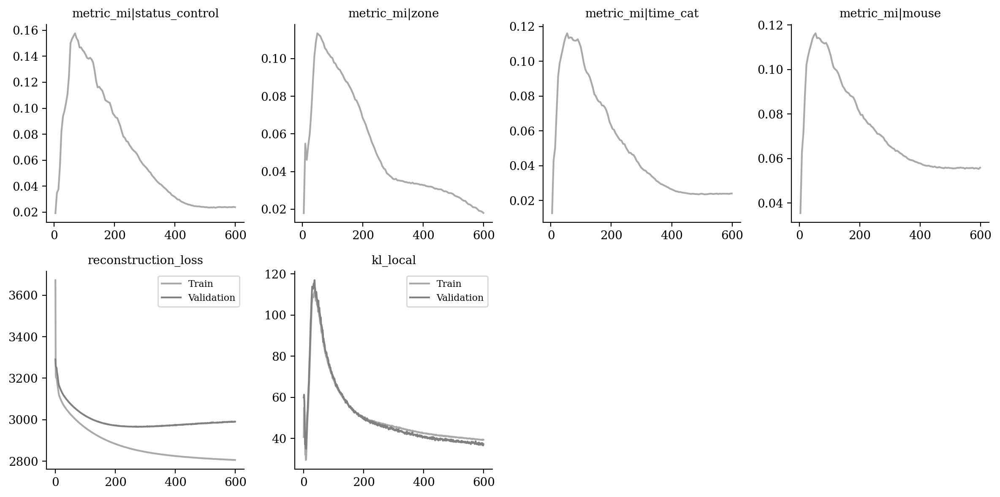

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

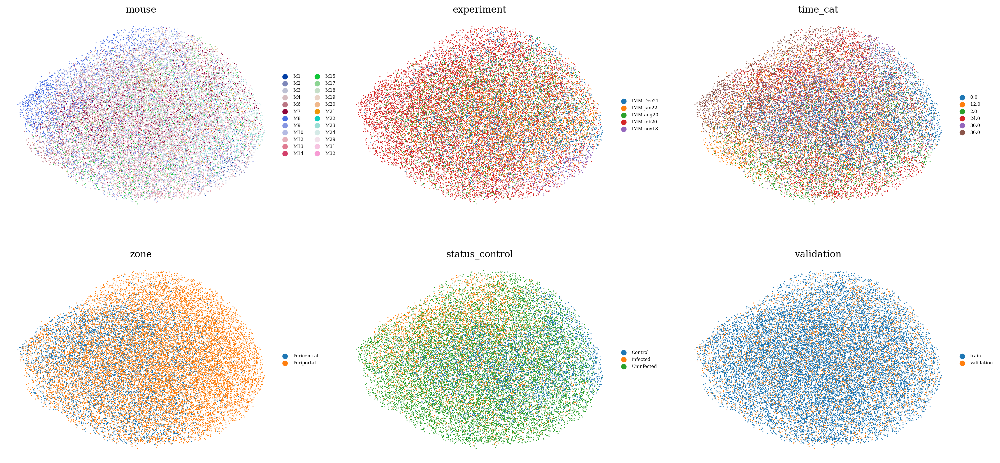

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

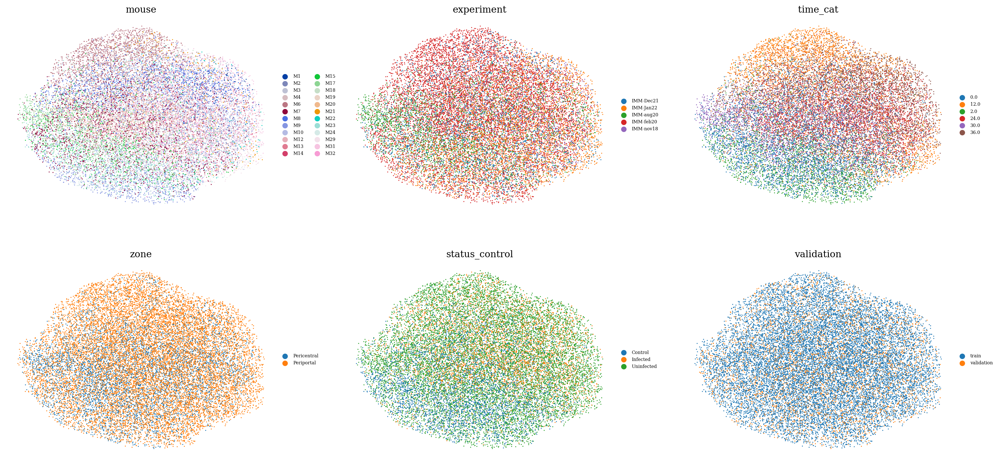

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

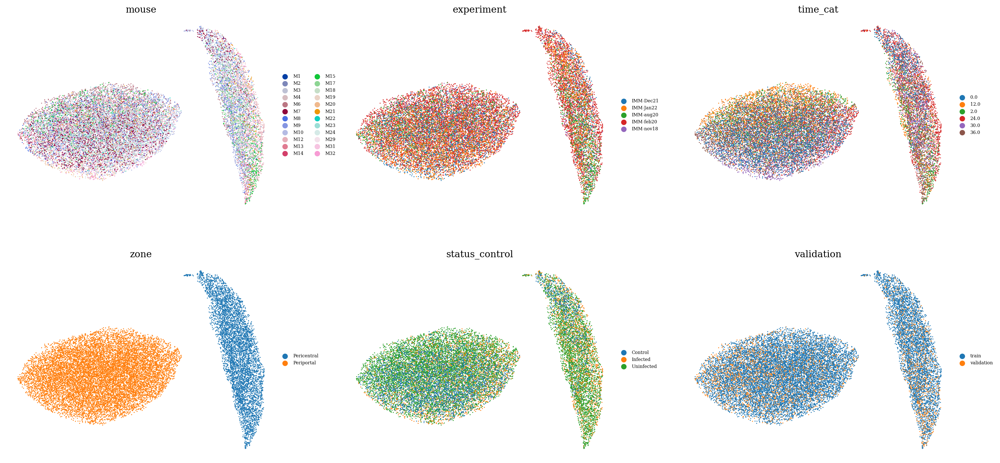

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

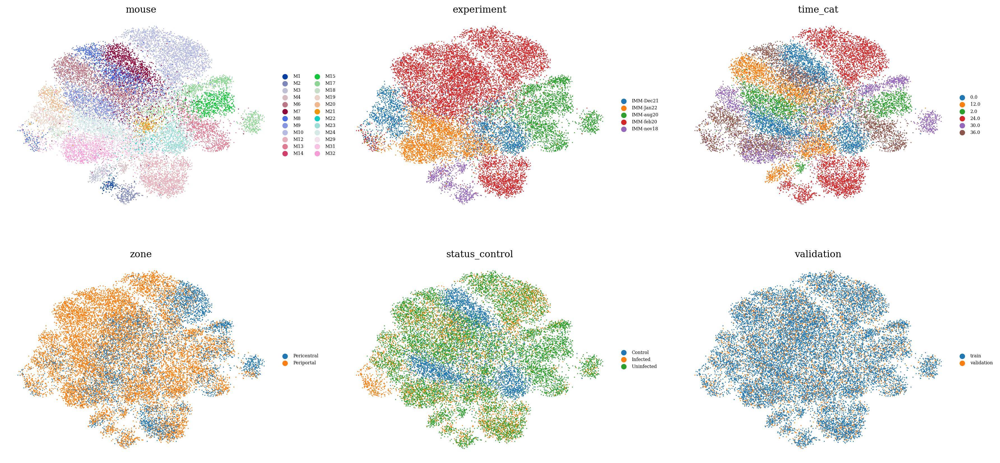

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

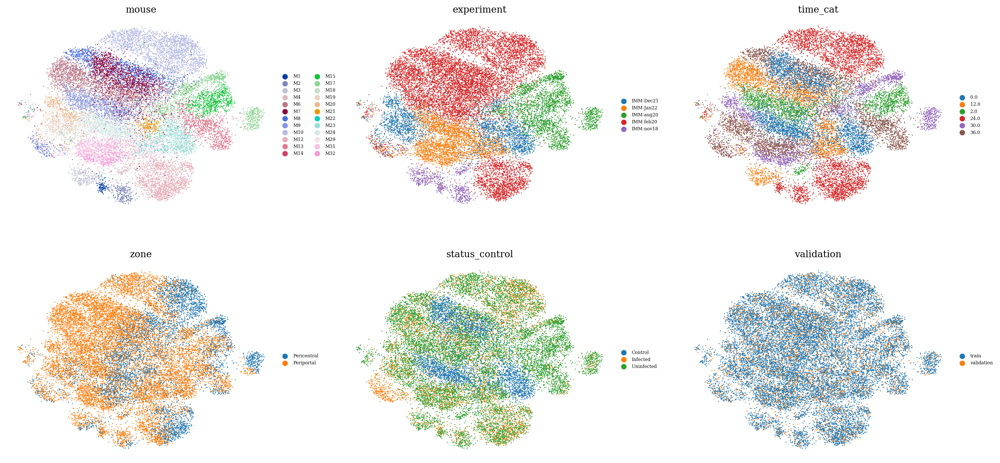

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

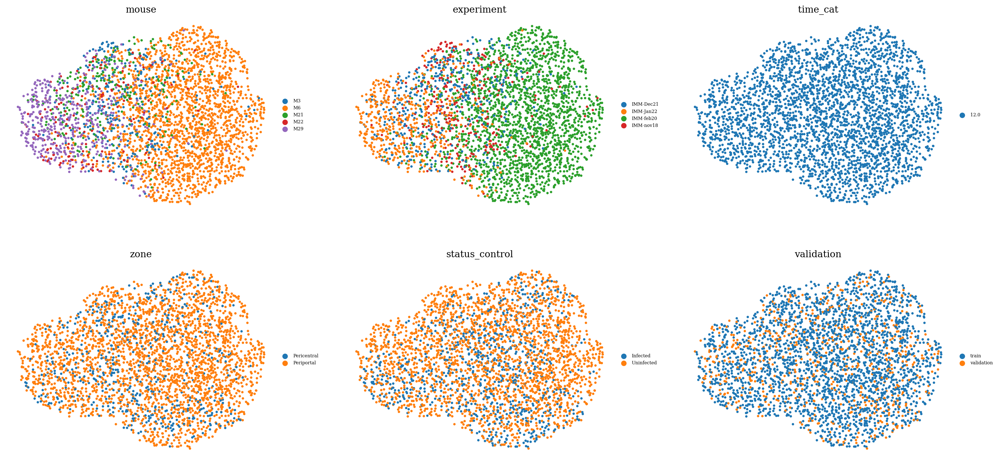

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )